<a href="https://colab.research.google.com/github/AribelGuzman/Regularization_Models/blob/main/Modelos_Regularizacion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Segundo taller de Análisis cuantitativo: Modelos de Regularización y Utilización de Distancias de Mahalanobis para Detección de Atípicos Multivariantes**


**Diana Guzmán Granobles.**
Universidad Icesi.

**Sebastián Barrera Peña.**
Universidad Autónoma.

**Gustavo Restrepo Figueroa.**
Universidad Icesi.

# **Resumen**

El análisis multivariado juega un papel crucial en diversas áreas, desde la ciencia de datos hasta la investigación social. A medida que aumenta la complejidad de los conjuntos de datos, es importante utilizar modelos de regresión robustos y técnicas de detección de observaciones atípicas efectivas. En este trabajo, se realiza una comparación entre tres modelos de regularización populares: Modelo Ridge, Modelo Lasso y Modelo Elastic-Net, y se explora el uso de las distancias de Mahalanobis en el análisis multivariado.

Los modelos de regularización, como el Modelo Ridge, el Modelo Lasso y el Modelo Elastic-Net, son enfoques ampliamente utilizados para abordar el problema de multicolinealidad y selección de características en el análisis de regresión. Estos modelos aplican penalizaciones a los coeficientes de regresión para evitar el sobreajuste y mejorar la generalización del modelo. El Modelo Ridge introduce una penalización L2, el Modelo Lasso utiliza una penalización L1 y el Modelo Elastic-Net combina ambas penalizaciones.

En el contexto del análisis multivariado, también es crucial identificar observaciones atípicas que puedan afectar significativamente los resultados del modelo. Para esto, se propone el uso de las distancias de Mahalanobis, que proporcionan una medida de la distancia entre cada observación y la distribución de los datos. Las distancias de Mahalanobis se basan en la matriz de covarianza o en la matriz de correlación, y permiten identificar observaciones atípicas teniendo en cuenta la estructura multivariada de los datos.

En este estudio, se encontró los modelos de regularización, como el Modelo Ridge, el Modelo Lasso y el Modelo Elastic-Net, son herramientas valiosas en el análisis multivariado para abordar el problema de multicolinealidad y selección de características. Además, la combinación de los modelos de regularización con las distancias de Mahalanobis permitió una identificación más efectiva de las observaciones atípicas en el análisis multivariado. 

**Palabras clave**: *Modelos de Regularización, Modelo Ridge, Modelo Lasso, Modelo Elastic-Net, Distancias de Mahalanobis*

# **Introducción**

En el análisis de regresión, los modelos de regularización han ganado reconocimiento y popularidad debido a su capacidad para controlar el sobreajuste y mejorar la precisión predictiva. Entre estos modelos, el Modelo Ridge, el Modelo Lasso y el Modelo Elastic-Net se han destacado por su efectividad en el manejo de problemas como la multicolinealidad y la selección de características.

El Modelo Ridge introduce una penalización L2 que reduce la magnitud de los coeficientes de regresión, mientras que el Modelo Lasso aplica una penalización L1 que puede reducir algunos coeficientes a cero, realizando una selección automática de características. Por otro lado, el Modelo Elastic-Net combina las penalizaciones L1 y L2, permitiendo un equilibrio flexible entre la selección de características y la reducción de coeficientes.

La penalización L1, también conocida como "Lasso", se refiere a la norma L1 aplicada a los coeficientes de regresión. La norma L1 es la suma de los valores absolutos de los coeficientes. Al aplicar esta penalización en el modelo de regresión, se favorece la selección de características relevantes, ya que algunos coeficientes pueden reducirse a cero, eliminando así las variables menos importantes. Esto proporciona un método de selección automática de características y puede resultar en un modelo más interpretable y eficiente.

La penalización L2, también conocida como "Ridge", se refiere a la norma L2 aplicada a los coeficientes de regresión. La norma L2 es la raíz cuadrada de la suma de los cuadrados de los coeficientes. Al aplicar esta penalización en el modelo de regresión, se reduce la magnitud de los coeficientes, pero no necesariamente a cero. Esto ayuda a controlar la variabilidad de los coeficientes y reduce el impacto de las variables menos relevantes en el modelo. La penalización L2 también puede ayudar a mitigar los problemas de multicolinealidad en el conjunto de datos.

En este estudio, se explorará la utilidad y el rendimiento de los Modelos de Regularización, como el Modelo Ridge, el Modelo Lasso y el Modelo Elastic-Net, en combinación con las distancias de Mahalanobis en el análisis multivariado. Se examinará cómo estas técnicas pueden mejorar la precisión predictiva, la selección de características y la detección de observaciones atípicas.

A lo largo del artículo, se presentarán los resultados obtenidos al aplicar estas técnicas en conjuntos de datos reales, y se discutirán las implicaciones y las oportunidades para futuras investigaciones en el campo de los Modelos de Regularización y las Distancias de Mahalanobis en el análisis multivariado.

# **Metodología**

Para cada base de datos (Boston Housing Data, YearPredictionMSD y California Housing Dataset) se realizarán, en general, los siguientes pasos, a fin de encontrar el modelo que mejor se ajuste a los datos:

Análisis Exploratorio de Datos, Incluye análisis de la forma de la base de datos, tipos de datos, estadísticas generales, datos faltantes, análisis univariado, análisis multivariado y datos atípicos.

Entrenamiento del modelo y análisis de sus residuales (validación de los supuestos del modelo)

Entrenamiento de modelos ajustados debido a peticiones específicas, problemas con algún supuesto, reducción de dimensionalidad o necesidad de robustez y su respectivo análisis de residuales (validación de los supuestos del modelo)

# **Resultados:**

## **Cargue de Librerías y complementos**

In [ ]:
import pandas as pd   ## Libreria para manipular y analizar datos
import matplotlib.pyplot as plt  ## Libreria para visualizar
import seaborn as sns   ## Libreria para visualizar
import numpy as np  ## Libreria para operaciones numéricas
import plotly  ## Libreria para visualizaciones interactivas
import matplotlib.ticker as mtick  ## función para formatear en visualizaciones
from scipy.stats import pearsonr ## Coeficiente de correlación de Pearson con prueba
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LassoCV, ElasticNet, ElasticNetCV ## Modelos de regularización
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import statsmodels.stats as sm  ## estadísticas
import statsmodels.api as sm1  ## estadísticas
import statsmodels.stats.api as sms
from scipy.stats import skew, kurtosis  ## funciones estadísticas
import statsmodels.stats.api as sms
from statsmodels.compat import lzip
from scipy.stats import ttest_1samp
import statsmodels.api as sm
from sklearn.metrics import mean_squared_error
from scipy.stats import chi2
from statsmodels.stats.stattools import durbin_watson
from statsmodels.stats.diagnostic import het_breuschpagan

import warnings
warnings.filterwarnings('ignore')

In [ ]:
pip install sklearn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached sklearn-0.0.post5.tar.gz (3.7 kB)
  Preparing metadata (setup.py) ... done
  Created wheel for sklearn: filename=sklearn-0.0.post5-py3-none-any.whl size=2950 sha256=0cea6bc57defd017e7f4c3ad257133e90e9cdd6bfdbfc18ad881c1316f024362
  Stored in directory: /root/.cache/pip/wheels/38/1f/8d/4f812c590e074c1e928f5cec67bf5053b71f38e2648739403a
Successfully built sklearn


# **Punto 1:**

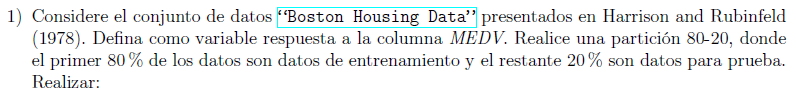

In [ ]:
# Carga de Datos
URL = "http://lib.stat.cmu.edu/datasets/boston" 
Boston_Housing_Data=pd.read_csv(URL, sep="\s+", skiprows=22, header=None)
Boston_Housing_Data.head(3)

,0,1,2,3,4,5,6,7,8,9,10
0,0.00632,18.00,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3
1,396.90000,4.98,24.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.02731,0.00,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8


In [ ]:
# Crear una lista para almacenar las filas combinadas
filas_combinadas = []

# Iterar sobre las filas del conjunto de datos
for i in range(0, len(Boston_Housing_Data), 2):
    fila_combinada = Boston_Housing_Data.iloc[i:i+2].values.reshape(-1)
    filas_combinadas.append(fila_combinada)

# Crear un nuevo DataFrame con las filas combinadas
Boston_Housing_Data = pd.DataFrame(filas_combinadas)
Boston_Housing_Data.head(3)

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,...,4.98,24.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,...,9.14,21.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,...,4.03,34.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Eliminar las columnas del 14 al 21
Boston_Housing_Data = Boston_Housing_Data.drop(columns=range(14, 22))
Boston_Housing_Data.head(3)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7


**Descripción de las variable**

**CRIM-**     tasa de criminalidad per cápita por ciudad

**ZN-**      proporción de suelo residencial zonificado para lotes de más de 25,000 pies cuadrados.

 **INDUS-**    proporción de acres comerciales no minoristas por ciudad

 **CHAS-**     Variable ficticia de Charles River (= 1 si el tramo limita con el río; 0 en caso contrario)

 **NOX-**      Concentración de óxidos nítricos (partes por 10 millones)

 **RM-**       promedio de cuartos por vivienda

 **AGE-**      Proporción de unidades ocupadas por sus propietarios construidas antes de 1940

 **DIS-**      distancias ponderadas los centros de empleo de Boston

 **RAD-**      índice de accesibilidad a las carreteras radiales

 **TAX-**      Tasa de impuesto a la propiedad de valor total por $ 10,000

 **PTRATIO-**  Proporción de alumnos por maestro por ciudad

 **B-**        1000(Bk - 0.63)^2 donde Bk es la proporción de negros por ciudad

 **LSTAT-**    % estado más bajo de la población

 **MEDV-**     Valor medio de las viviendas ocupadas por sus propietarios en miles de dólares


In [ ]:
column_names = ['CRIM', 'ZN', 'INDUS', 'CHAS', 'NOX', 'RM', 'AGE', 
                'DIS', 'RAD', 'TAX', 'PTRATIO', 'B', 'LSTAT', 'MEDV']

Boston_Housing_Data.columns = column_names
Boston_Housing_Data.head(3)

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7


### **Análisis Exploratorio de Datos:**

El conjunto de datos **Boston Housing** contiene información recopilada por el Servicio de Censos de los Estados Unidos en 1970 sobre diferentes aspectos de la vivienda en varias áreas de Boston. Está compuesto por 506 filas y 14 columnas, donde cada fila representa una ubicación geográfica específica en Boston y cada columna contiene diferentes características relacionadas con la vivienda.

Las características incluyen variables como la tasa de criminalidad per cápita por ciudad, el porcentaje de tierras residenciales divididas en zonas para lotes de más de 25,000 pies cuadrados, la concentración de óxidos nitrosos, la cantidad promedio de habitaciones por vivienda, la proporción de estudiantes y maestros en las escuelas locales, entre otros.

El objetivo principal de este conjunto de datos es predecir el valor medio de las viviendas ocupadas por sus propietarios en miles de dólares. 

### **Forma del dataset**

Explorar la forma general del dataset utilizando funciones como shape, head, tail, dtypes e isnull es importante por varias razones:

**Dimensiones del dataset (shape)**: La función shape proporciona el número de filas y columnas del dataset. Conocer las dimensiones del dataset es fundamental para comprender el tamaño del conjunto de datos con el que se está trabajando y estimar la cantidad de información disponible.

**Visualización de los primeros y últimos registros (head y tail)**: Las funciones head y tail permiten ver una muestra de los primeros y últimos registros del dataset, respectivamente. Esto es útil para obtener una idea de la estructura y el contenido de los datos, así como para verificar si los datos se cargaron correctamente y cumplen con las expectativas iniciales.

**Tipos de datos de las columnas (dtypes)**: La función dtypes muestra los tipos de datos de cada columna en el dataset. Conocer los tipos de datos es importante para comprender cómo se almacenan los datos y qué operaciones se pueden realizar con ellos. Además, ayuda a identificar posibles errores de tipo, como una columna que debería ser numérica pero se carga como texto.

**Valores faltantes (isnull)**: La función isnull permite identificar los valores faltantes en el dataset. Los valores faltantes pueden afectar el análisis y los resultados, por lo que es esencial detectarlos y decidir cómo manejarlos. Conocer la cantidad y la ubicación de los valores faltantes ayuda a determinar si es necesario aplicar técnicas de imputación o eliminar ciertas filas o columnas del dataset.

In [ ]:
# Revisión de la forma de la matriz en términos de filas y columnas.
Boston_Housing_Data.shape

(506, 14)

In [ ]:
# Revisión de los primeros datos de la matriz.
Boston_Housing_Data.head(3)

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7


In [ ]:
#Verificando el tipo de datos de cada una de las variables de la matriz:
Boston_Housing_Data.dtypes

CRIM       float64
ZN         float64
INDUS      float64
CHAS       float64
NOX        float64
RM         float64
AGE        float64
DIS        float64
RAD        float64
TAX        float64
PTRATIO    float64
B          float64
LSTAT      float64
MEDV       float64
dtype: object

In [ ]:
# Revisión de las métricas estadísticas descriptivas de las variables numéricas
def fun_tabla_descriptivas(columnas):
    tabla_descriptivas=pd.DataFrame(columnas.describe())
    tabla_descriptivas.loc['coef. variation']=columnas.std()/columnas.mean()
    tabla_descriptivas.loc['skew']=skew(columnas)
    tabla_descriptivas.loc['kurtosis']=kurtosis(columnas)
    return tabla_descriptivas

In [ ]:
fun_tabla_descriptivas(Boston_Housing_Data)

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
count,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000
mean,3.613524,11.363636,11.136779,0.069170,0.554695,6.284634,68.574901,3.795043,9.549407,408.237154,18.455534,356.674032,12.653063,22.532806
std,8.601545,23.322453,6.860353,0.253994,0.115878,0.702617,28.148861,2.105710,8.707259,168.537116,2.164946,91.294864,7.141062,9.197104
min,0.006320,0.000000,0.460000,0.000000,0.385000,3.561000,2.900000,1.129600,1.000000,187.000000,12.600000,0.320000,1.730000,5.000000
25%,0.082045,0.000000,5.190000,0.000000,0.449000,5.885500,45.025000,2.100175,4.000000,279.000000,17.400000,375.377500,6.950000,17.025000
50%,0.256510,0.000000,9.690000,0.000000,0.538000,6.208500,77.500000,3.207450,5.000000,330.000000,19.050000,391.440000,11.360000,21.200000
75%,3.677083,12.500000,18.100000,0.000000,0.624000,6.623500,94.075000,5.188425,24.000000,666.000000,20.200000,396.225000,16.955000,25.000000
max,88.976200,100.000000,27.740000,1.000000,0.871000,8.780000,100.000000,12.126500,24.000000,711.000000,22.000000,396.900000,37.970000,50.000000
coef. variation,2.380376,2.052376,0.616009,3.672028,0.208903,0.111799,0.410483,0.554858,0.911812,0.412841,0.117306,0.255962,0.564374,0.408165
skew,5.207652,2.219063,0.294146,3.395799,0.727144,0.402415,-0.597186,1.008779,1.001833,0.667968,-0.799945,-2.881798,0.903771,1.104811


In [ ]:
# Revisión del porcentaje de datos nulos en cada una de las variables
Boston_Housing_Data.isnull().sum()/len(Boston_Housing_Data)*100

CRIM       0.0
ZN         0.0
INDUS      0.0
CHAS       0.0
NOX        0.0
RM         0.0
AGE        0.0
DIS        0.0
RAD        0.0
TAX        0.0
PTRATIO    0.0
B          0.0
LSTAT      0.0
MEDV       0.0
dtype: float64

En general, se observa que es un buen dataset, contiene variables numéricas tipo float y no se observan datos nulos.

### **Visualización de los Datos:**

#### *Análisis Univariado:*

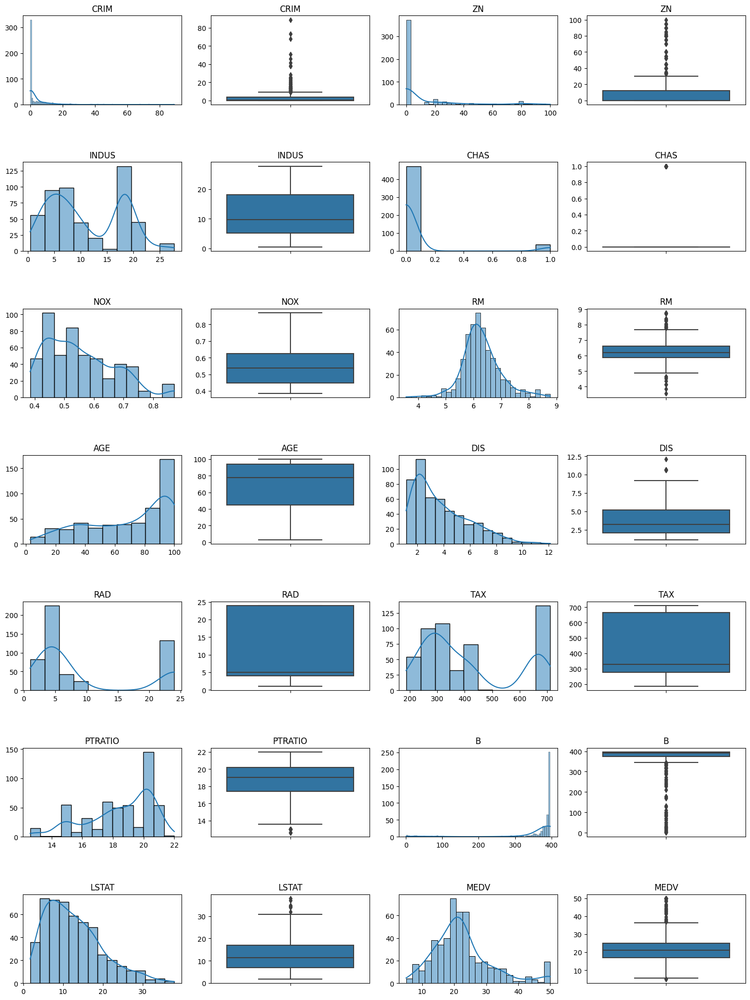

In [ ]:
# Graficando las distribuciones de cada variable:
fig, axs = plt.subplots(ncols=8, nrows=4, figsize=(15, 20))
axs = axs.flatten()

plotnumber = 2

for col in Boston_Housing_Data.columns:
    if plotnumber <= 28:
       
        ax = plt.subplot(7, 4, plotnumber - 1)        
        sns.histplot(x=Boston_Housing_Data[col],kde=True)
        ax.set_title(col, loc="center")
        plt.ylabel("")
        plt.xlabel("")
              
        ax = plt.subplot(7, 4, plotnumber)  
        sns.boxplot(y=Boston_Housing_Data[col])
        plt.ylabel("")
        ax.set_title(col, loc="center")
     
    plotnumber += 2

plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=5.0)
plt.show()

#### *Análisis Multivariado*

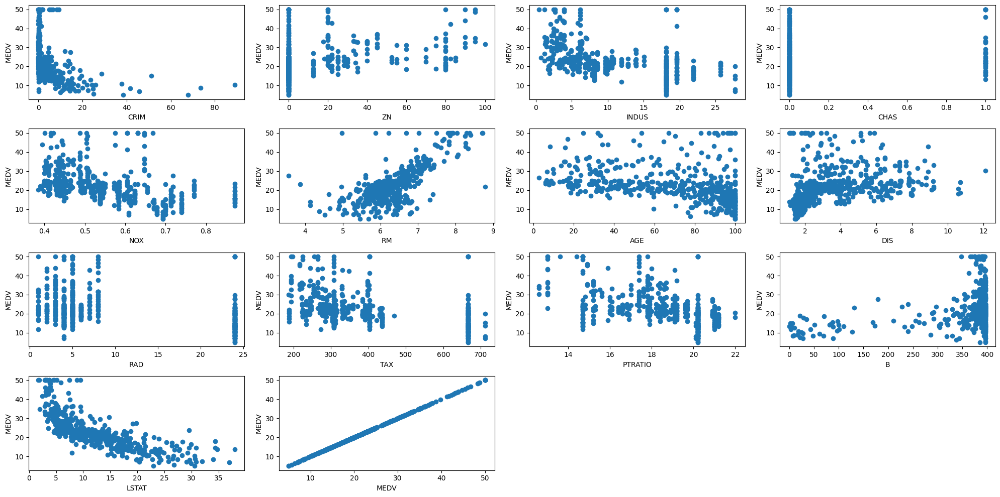

In [ ]:
Y = Boston_Housing_Data["MEDV"]

plt.figure(figsize = (20, 10))
plotnumber = 1

for col in Boston_Housing_Data.columns:
    if plotnumber <= 14:
        ax = plt.subplot(4, 4, plotnumber)
        plt.scatter(Boston_Housing_Data[col], Y)
        plt.xlabel(col)
        plt.ylabel("MEDV")
    plotnumber += 1
    
plt.tight_layout()
plt.show()

#### *Correlación entre variables*

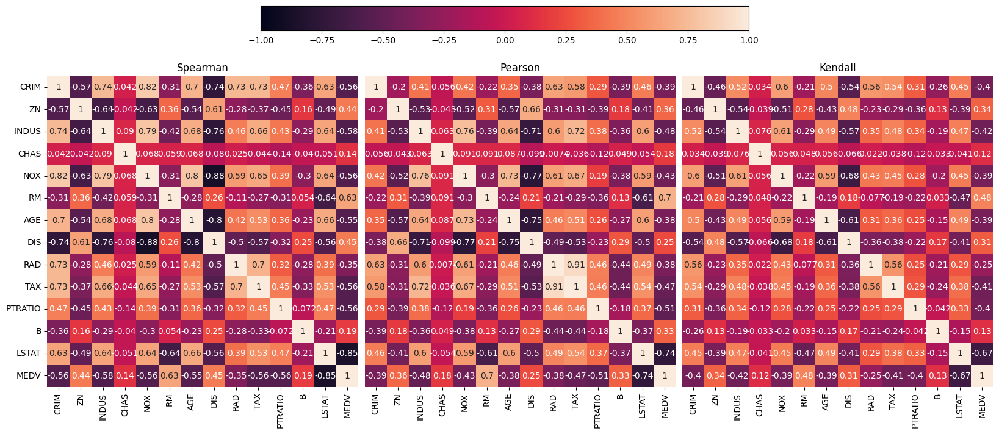

In [ ]:
fig, axs = plt.subplots(figsize=[20, 20], ncols=3)

Pearson_corr_matrix = Boston_Housing_Data.corr(method='pearson') # Calcular la matriz de correlación de Pearson
Kendall_corr_matrix = Boston_Housing_Data.corr(method='kendall') # Calcular la matriz de correlación de Kendall
Spearman_corr_matrix = Boston_Housing_Data.corr(method='spearman') # Calcular la matriz de correlación de Spearman

ax1 = sns.heatmap(Spearman_corr_matrix, annot=True, ax=axs[0], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax1.set_title("Spearman", fontsize=12)

ax2 = sns.heatmap(Pearson_corr_matrix, annot=True, ax=axs[1], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax2.set_title("Pearson", fontsize=12)
ax2.set_yticks([])

ax3 = sns.heatmap(Kendall_corr_matrix, annot=True, ax=axs[2], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax3.set_title("Kendall", fontsize=12)
ax3.set_yticks([])

cbar_ax = fig.add_axes([0.3, 0.66, 0.4, 0.02]) # [left, bottom, width, height]
fig.colorbar(ax1.collections[0], ax=axs, cax=cbar_ax, shrink=0.7, pad=0.05,orientation='horizontal')
fig.subplots_adjust(wspace=0.02)

plt.show()

### **Análisis y tratamiento de atípicos multivariantes:**

Antes de construir el modelo, conviene revisar la presencia de datos atípicos en los datos que puedan llegar a afectarlo. Para ello, se calculan las distancias de mahalanobis para identificar los atípicos multivariantes existentes:

Dado que el porcentaje de datos atípicos multivariantes presentes en los datos es bajo (menor al 5%), no se tiene suficiente contexto para su imputación y puesto que no se tiene contexto adicional que permita determinar si su eliminación significaría un alto costo para el negocio, se procede entonces a su eliminación.

In [ ]:
boston_clean=Boston_Housing_Data

### **Hold Out (80-20):**

In [ ]:
X = boston_clean.drop(["MEDV"], axis=1)
Y = boston_clean['MEDV']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

## **Parte A**

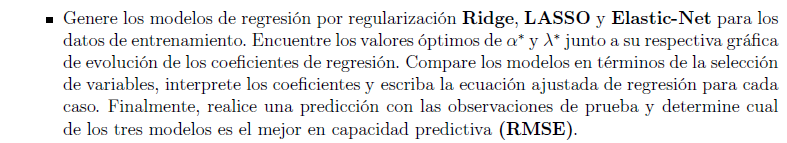

#### **Modelo OLS**

Previo a aplicar técnicas de regularización, como la regresión ridge o la regresión LASSO, es recomendable hacer una regresión lineal ordinaria (OLS). Aquí hay algunas razones por las cuales es recomendable hacerlo:

**Evaluación inicial del modelo:** La regresión lineal ordinaria proporciona una evaluación inicial de la relación entre las variables independientes y la variable dependiente. Esto te permite comprender la dirección y magnitud de la relación lineal antes de aplicar técnicas de regularización. Además, te permite identificar posibles problemas, como multicolinealidad o relaciones no lineales, que pueden afectar el rendimiento del modelo.

**Identificación de predictores relevantes:** La regresión lineal ordinaria puede ayudar a identificar los predictores más relevantes antes de aplicar regularización. Los coeficientes estimados en el modelo OLS te brindan información sobre la importancia relativa de cada predictor en la predicción de la variable objetivo. Esto puede servir como guía para seleccionar los predictores más relevantes o descartar aquellos con poca influencia antes de aplicar la regularización.

**Comparación de rendimiento:** Realizar una regresión lineal ordinaria antes de aplicar regularización te permite obtener una referencia para comparar el rendimiento de los modelos posteriores. Puedes evaluar si la regularización mejora la precisión de las predicciones y si logra una mejor generalización. Comparar los resultados del modelo OLS con los modelos regularizados nos ayudará a evaluar si la complejidad adicional introducida por la regularización es beneficiosa.

**Interpretación de coeficientes:** La regresión lineal ordinaria proporciona coeficientes de regresión fácilmente interpretables. Estos coeficientes te permiten comprender la dirección y el impacto relativo de cada predictor en la variable objetivo. 

In [ ]:
X = sm.add_constant(boston_clean.drop(["MEDV"], axis=1)) ## Variables explicativas o predictoras
model = sm.OLS(boston_clean['MEDV'], X) ## Variable dependiente
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                   MEDV   R-squared:                       0.741
Model:                            OLS   Adj. R-squared:                  0.734
Method:                 Least Squares   F-statistic:                     108.1
Date:                Wed, 31 May 2023   Prob (F-statistic):          6.72e-135
Time:                        01:35:50   Log-Likelihood:                -1498.8
No. Observations:                 506   AIC:                             3026.
Df Residuals:                     492   BIC:                             3085.
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         36.4595      5.103      7.144      0.0

In [ ]:
# Predecir los valores de la variable dependiente
y_pred = results.predict(X)

# Calcular el RMSE
rmse = np.sqrt(mean_squared_error(boston_clean['MEDV'], y_pred))

print("RMSE:", rmse)

RMSE: 4.679191295697282


Este modelo tiene un R² ajustado de 0.82, el cual se considera una relación lineal **fuerte** (>0.7) entre las variables.

Además, el valor P de la significancia del modelo (Prob (F-statistic)) es menor que <= un alpha de 0.05, por tanto, se puede decir que hay modelo.

Las predicciones del modelo se alejan en promedio 3.64 unidades del valor real.

No obstante, al revisar los valores P de los coeficiente de las variables, se encuentra que algunas de variables no son significativas en sí mismas dentro del modelo (valor P >= alpha de 0.05), por tanto, se procederá a eliminarlas del modelo (INDUS y CHAS) más adelante. Antes se graficarán los coeficientes de cada variable para observar su aporte:

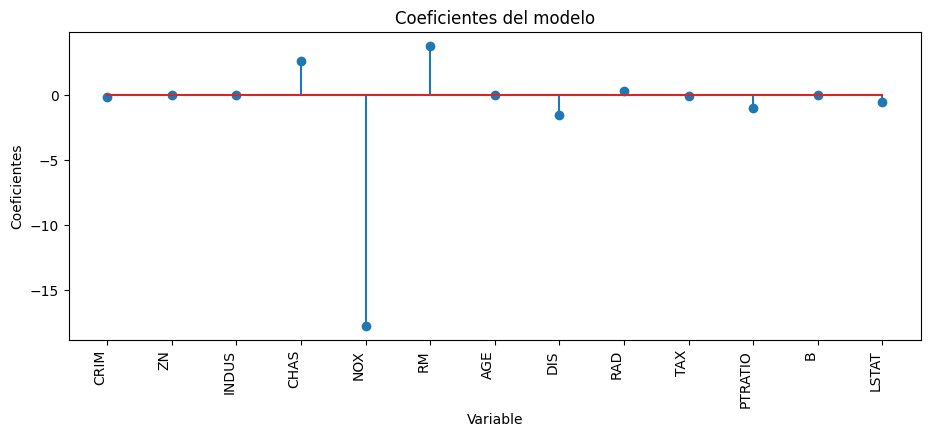

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Coeficientes del modelo
df_coeficientes = pd.DataFrame({'predictor': X_train.columns, 'coef': results.params[1:]})

fig, ax = plt.subplots(figsize=(11, 4))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, use_line_collection=True)
plt.xticks(rotation=90, ha='right', size=10)
ax.set_xlabel('Variable')
ax.set_ylabel('Coeficientes')
ax.set_title('Coeficientes del modelo')
plt.show()


Los coeficientes más 

**Modelo ajustado:**

Se eliminan, de a una, las variables con los coeficientes cuyos valores P son mayores a un alpha de 0.05, de mayor a menor, verificando cada vez si cambian los valores P de las demás variables:

In [ ]:
X = sm.add_constant(boston_clean.drop(["MEDV","INDUS","CHAS"], axis=1)) ## Variables explicativas o predictoras
model = sm.OLS(boston_clean['MEDV'], X) ## Variable dependiente
results = model.fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                   MEDV   R-squared:                       0.735
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     124.7
Date:                Wed, 31 May 2023   Prob (F-statistic):          7.89e-135
Time:                        01:35:50   Log-Likelihood:                -1504.0
No. Observations:                 506   AIC:                             3032.
Df Residuals:                     494   BIC:                             3083.
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         36.7119      5.136      7.148      0.0

In [ ]:
# Predecir los valores de la variable dependiente
y_pred = results.predict(X)

# Calcular el RMSE
rmse_OLS = np.sqrt(mean_squared_error(boston_clean['MEDV'], y_pred))

print("RMSE:", rmse_OLS)

RMSE: 4.727251469932942


Este modelo tiene un R² ajustado de 0.82, el cual se considera una relación lineal **fuerte** (>0.7) entre las variables.

Además, el valor P de la significancia del modelo (Prob (F-statistic)) es menor que <= un alpha de 0.05, por tanto, se puede decir que hay modelo.

Las predicciones del modelo se alejan en promedio 3.65 unidades del valor real.

Evidentemente, el modelo nuevo no mejoró siginifcativamente con respecto al anterior. Se observan algunos problemas, por tanto, se procede entonces a validar los supuestos del mismo:

### **Validación de supuestos**

**1. Autocorrelación en los errores:**

* H0: No hay autocorrelación en los errores
* H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 1.18 de la prueba Durbin-Watson que no está entre 1.5 y 2.5, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que existe autocorrelación entre los errores.

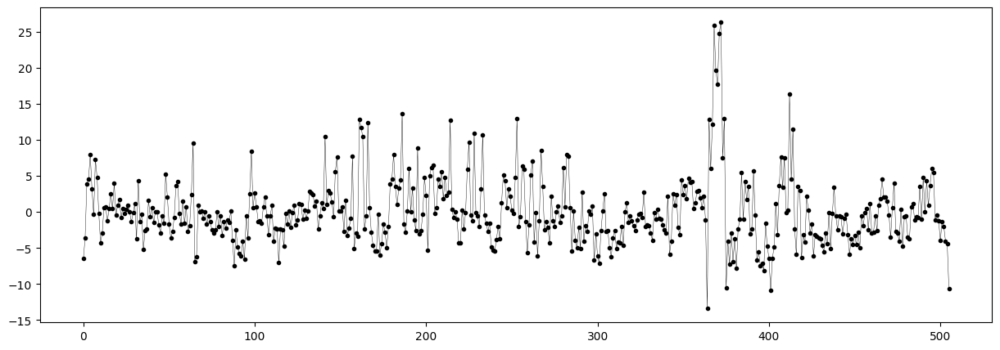

In [ ]:
#Gráfico de errores vs i:

plt.figure(figsize = (15, 5))
plt.plot(results.resid, '.-', color = "black", linewidth = 0.3)
plt.show()

**2. Distribución normal de los datos:**
*   H0: Los errores se distribuyen normal
*   H1: Los errores no se distribuyen normal

Dado un valor P de 0.00 de la prueba Jarque-Bera menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los datos no se distribuyen normal.

<function matplotlib.pyplot.show(close=None, block=None)>

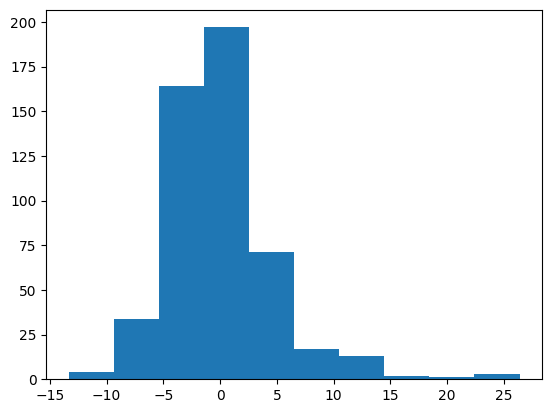

In [ ]:
plt.hist(results.resid)
plt.show

**3. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.99 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero. Es decir, se podría asumir una media de errores igual a cero.

In [ ]:
# Obtener los residuos del modelo
residuals = results.resid

# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(residuals, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

One-sample t-test para la media de los residuos:
T-statistic: 1.899816110568444e-13
P-value: 0.9999999999998486


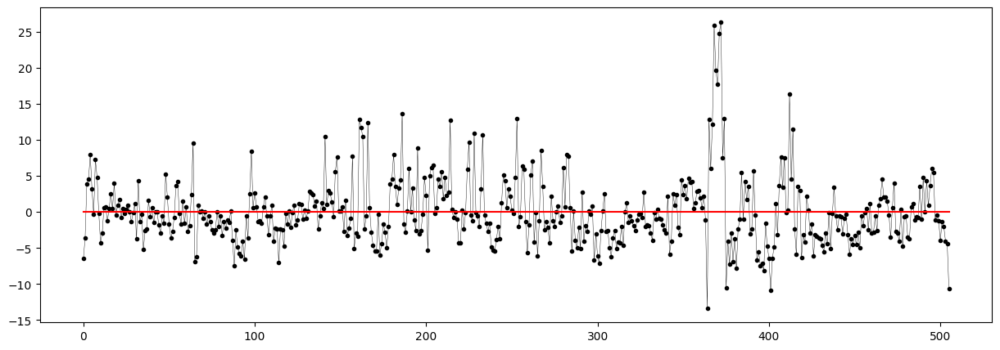

In [ ]:
plt.figure(figsize = (15, 5))
plt.plot(results.resid, '.-', color = "black", linewidth = 0.3)
plt.plot([0,505], [0,0], color = "red")
plt.show()

**4. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0.00 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los errores no son homocedásticos. Es decir, no se podría asumir homocedasticidad.

In [ ]:
test = sms.het_breuschpagan(results.resid, results.model.exog)
name = ["Lagrange multiplier statistic", "p-value", "f-value", "f p-value"]
lzip(name, test)

[('Lagrange multiplier statistic', 60.20974823923862),
 ('p-value', 8.476358643454494e-09),
 ('f-value', 6.065554476818298),
 ('f p-value', 2.400287838782121e-09)]

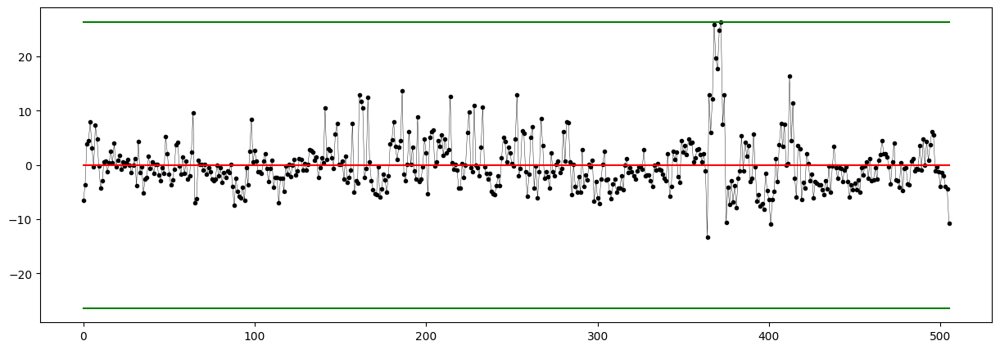

In [ ]:
#Gráfico de errores vs i, con media cero y varianza constante:

mx=max(results.resid)

plt.figure(figsize = (15, 5))
plt.plot(results.resid, '.-', color = "black", linewidth = 0.3)
plt.plot([0,505], [0,0], color = "red")
plt.plot([0,505], [mx,mx], color = "green")
plt.plot([0,505], [-mx,-mx], color = "green")

plt.show()

### **Modelo de Regularización Ridge**



El modelo de regularización Ridge, es una técnica que se utiliza para abordar problemas de multicolinealidad y reducir la varianza en modelos de regresión lineal. A continuación, se enumeran algunas de las bondades:

**Reducción de la multicolinealidad:** La regresión Ridge es especialmente útil cuando hay variables predictoras altamente correlacionadas en el modelo. Al agregar un término de penalización a la función de costo, la regresión Ridge reduce la influencia de las variables altamente correlacionadas, lo que ayuda a evitar la inestabilidad y la amplificación del ruido en las estimaciones de los coeficientes.

**Control de la complejidad del modelo:** La regresión Ridge permite controlar la complejidad del modelo mediante un parámetro de regularización llamado "lambda" o "alpha". Este parámetro determina el grado de penalización aplicado a los coeficientes y regula el equilibrio entre ajuste y regularización. Al ajustar el valor de lambda, se puede controlar la cantidad de contracción aplicada a los coeficientes, lo que permite encontrar un equilibrio óptimo entre sesgo y varianza.

**Manejo de conjuntos de datos de alta dimensionalidad:** La regresión Ridge es especialmente útil cuando se trabaja con conjuntos de datos que tienen un gran número de variables predictoras (alta dimensionalidad). Al penalizar los coeficientes, la regresión Ridge puede reducir la magnitud de los coeficientes menos importantes, evitando así el sobreajuste y mejorando la capacidad del modelo para generalizar a nuevos datos.

In [ ]:
## Generamos la grilla con alphas/lambdas

alphas_array = np.logspace(-10, 2, 100)

In [ ]:
## Cross-validation para elegir el alpha con mejor performance:

ridge_CV = RidgeCV(alphas = alphas_array, cv=10).fit(X_train, Y_train)
elegido=ridge_CV.alpha_
elegido

1e-10

In [ ]:
## Ridge Regression Model
model_Ridge = Ridge(alpha = elegido) #un solo alpha, pero debemos usar el ridge con Cross Validation 

model_Ridge.fit(X_train, Y_train)

## Score ridge regression
model_Ridge.score(X_train, Y_train)

0.7508856358979673

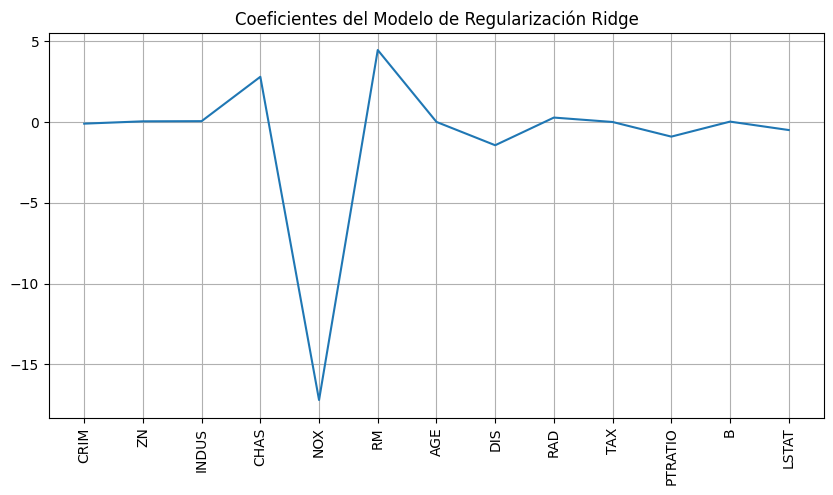

In [ ]:
# Obtención de los coeficientes del modelo Ridge
coeficients = model_Ridge.coef_

plt.figure(figsize = (10, 5))
plt.plot(X_train.columns, coeficients)
plt.xticks(rotation = 90)
plt.title("Coeficientes del Modelo de Regularización Ridge")
plt.grid(True)
plt.show()

In [ ]:
# Predicciones en el conjunto de prueba
y_pred = model_Ridge.predict(X_test)

# Calcular el RMSE
rmse_Ridge = np.sqrt(mean_squared_error(Y_test, y_pred))

print("RMSE:", rmse_Ridge)

RMSE: 4.928602182665921


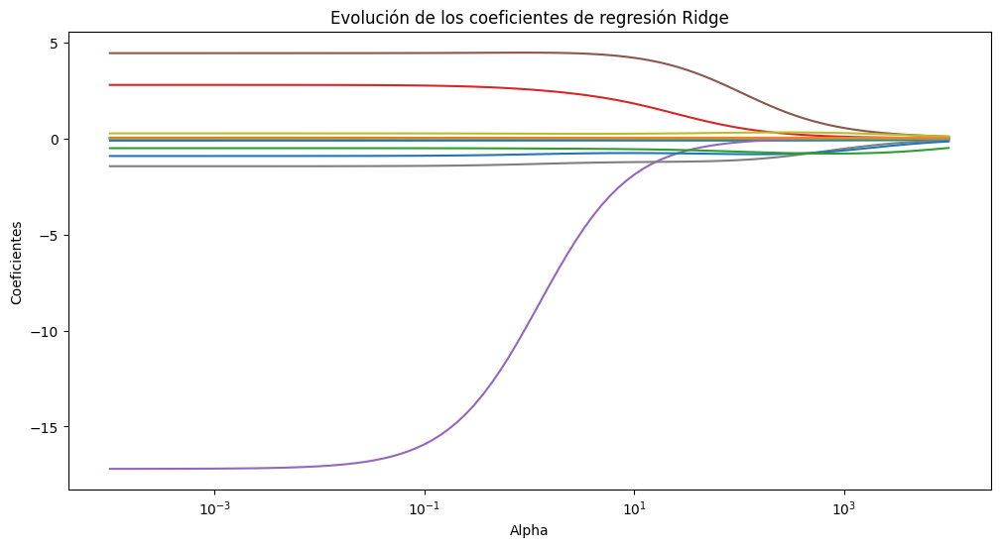

Valor óptimo de alpha: 5.857020818056673


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error

# Lista de valores de alpha que se probarán
alphas = np.logspace(-4, 4, 100)

# Lista para almacenar los coeficientes de regresión
coefs = []

# Entrenar el modelo Ridge con diferentes valores de alpha
for alpha in alphas:
    ridge = Ridge(alpha=alpha)
    ridge.fit(X_train, Y_train)
    coefs.append(ridge.coef_)

# Calcular el error cuadrático medio en el conjunto de prueba para cada valor de alpha
mse_scores = [mean_squared_error(Y_test, X_test.dot(coef)) for coef in coefs]

# Encontrar el índice del valor óptimo de alpha con el menor error cuadrático medio
best_alpha_index = np.argmin(mse_scores)
best_alpha = alphas[best_alpha_index]

# Graficar la evolución de los coeficientes de regresión en función de alpha
plt.figure(figsize=(12, 6))
plt.plot(alphas, coefs)
plt.xscale('log')
plt.xlabel('Alpha')
plt.ylabel('Coeficientes')
plt.title('Evolución de los coeficientes de regresión Ridge')
plt.show()

# Imprimir el valor óptimo de alpha
print("Valor óptimo de alpha:", best_alpha)


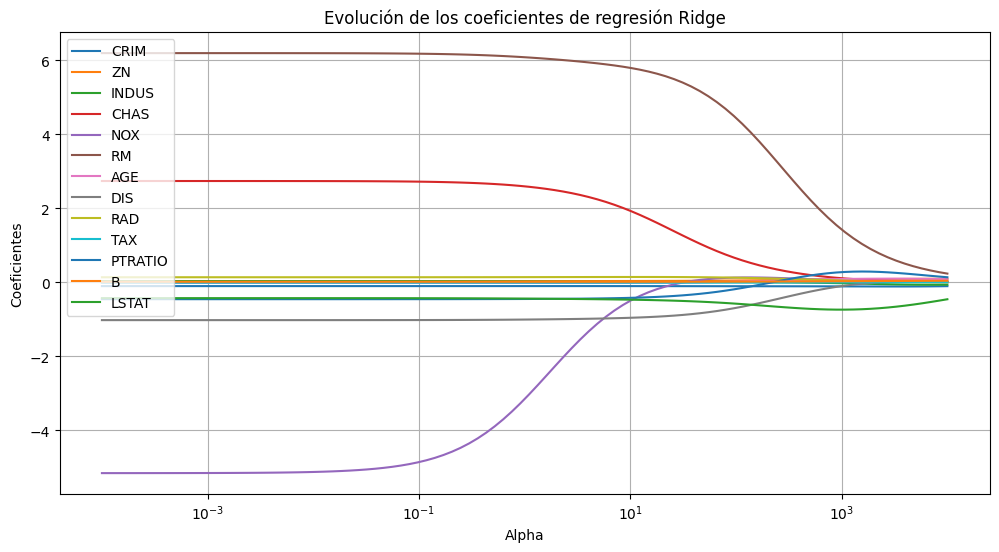

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge


# Inicializar listas para almacenar los coeficientes y alphas
coeficientes = []
alphas = []

# Lista de valores de alpha que se probarán
alphas_array = np.logspace(-4, 4, 100)

# Iterar sobre los alphas y ajustar los modelos Ridge
for alpha in alphas_array:
    model_Ridge = Ridge(alpha=alpha, fit_intercept=False)
    model_Ridge.fit(X_train, Y_train)
    coeficientes.append(model_Ridge.coef_)
    alphas.append(alpha)

# Convertir las listas en arrays numpy
coeficientes = np.array(coeficientes)
alphas = np.array(alphas)

# Graficar la evolución de los coeficientes vs alphas
plt.figure(figsize=(12, 6))
for i in range(coeficientes.shape[1]):
    plt.plot(alphas, coeficientes[:, i], label=X_train.columns[i])

plt.xscale('log')
plt.xlim(alphas_array.min(), 100)  # Rango de alphas en el eje x
plt.xlabel('Alpha')
plt.ylabel('Coeficientes')
plt.title('Evolución de los coeficientes de regresión Ridge')
plt.legend()
plt.axis('tight')
plt.grid(True)
plt.show()


#### **Validación de supuestos:**

Se evaluarán todos los supuestos, salvo el supuesto de normalidad puesto que los modelos de regularización, introducen un sesgo en los estimadores de los coeficientes para controlar la varianza. Dado que los coeficientes estimados están sujetos a restricciones y pueden no seguir una distribución normal, los supuestos de normalidad sobre los errores pueden no ser aplicables directamente.

**1. Autocorrelación en los errores:**

* H0: No hay autocorrelación en los errores
* H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 1.96 de la prueba Durbin-Watson que está entre 1.5 y 2.5, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que existe autocorrelación entre los errores.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - model_Ridge.predict(X_train)

# Calcular la estadística de Durbin-Watson
dw_statistic = durbin_watson(residuals)

# Imprimir el valor de la estadística de Durbin-Watson
print("Estadística de Durbin-Watson:", dw_statistic)

# Comprobar la autocorrelación basada en el valor de la estadística
if dw_statistic < 1.5:
    print("Autocorrelación positiva")
elif dw_statistic > 2.5:
    print("Autocorrelación negativa")
else:
    print("No hay evidencia de autocorrelación")


Estadística de Durbin-Watson: 1.968759416527156
No hay evidencia de autocorrelación


**2. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.17 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero. Es decir, se podría asumir una media de errores igual a cero.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - model_Ridge.predict(X_train)

# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(residuals, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

One-sample t-test para la media de los residuos:
T-statistic: 1.357014775267024
P-value: 0.17553607058364976


**3. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0.00 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los errores no son homocedásticos.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - model_Ridge.predict(X_train)

# Realizar la prueba de Breusch-Pagan
_, p_value, _, _ = het_breuschpagan(residuals, X_train)
print(p_value)

# Imprimir el resultado de la prueba
if p_value < 0.05:
    print("La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).")
else:
    print("La prueba de Breusch-Pagan no rechaza el supuesto de homocedasticidad (no hay evidencia de heterocedasticidad).")

2.8912870051362573e-30
La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).


### **Modelo de Regularización Lasso**

El modelo Lasso tiene varias ventajas que lo hacen útil en ciertos escenarios:

**Selección de características:** El modelo Lasso puede llevar a cabo una selección automática de características, lo que significa que puede identificar y reducir coeficientes de variables irrelevantes a cero. Esto es especialmente útil en situaciones donde hay un gran número de variables predictoras y se desea identificar las más importantes.

**Regularización:** El modelo Lasso aplica una penalización L1 a los coeficientes, lo que impone una restricción en la magnitud total de los coeficientes. Esto ayuda a prevenir el sobreajuste y la sensibilidad excesiva a los datos de entrenamiento, mejorando así la capacidad de generalización del modelo.

**Interpretabilidad:** Debido a la selección de características que realiza el modelo Lasso, los coeficientes asociados a las variables irrelevantes se reducen a cero. Esto hace que el modelo sea más fácil de interpretar, ya que solo se incluyen las variables más relevantes en la predicción.

**Reducción de la dimensionalidad:** Al reducir coeficientes a cero, el modelo Lasso puede reducir la dimensionalidad del conjunto de variables predictoras. Esto es especialmente útil cuando se trabaja con conjuntos de datos grandes, ya que se pueden eliminar variables redundantes o irrelevantes, lo que facilita el análisis y mejora la eficiencia computacional.

**Robustez ante multicolinealidad:** El modelo Lasso es menos sensible a la multicolinealidad en comparación con otros métodos de regresión, como la regresión lineal estándar o el modelo Ridge. Esto significa que puede manejar mejor situaciones donde hay alta correlación entre las variables predictoras.

In [ ]:
## Lasso Regression Model
model_Lasso = Lasso(alpha = elegido)

model_Lasso.fit(X_train, Y_train)

## Score ridge regression
model_Lasso.score(X_train, Y_train)

0.7508856358979673

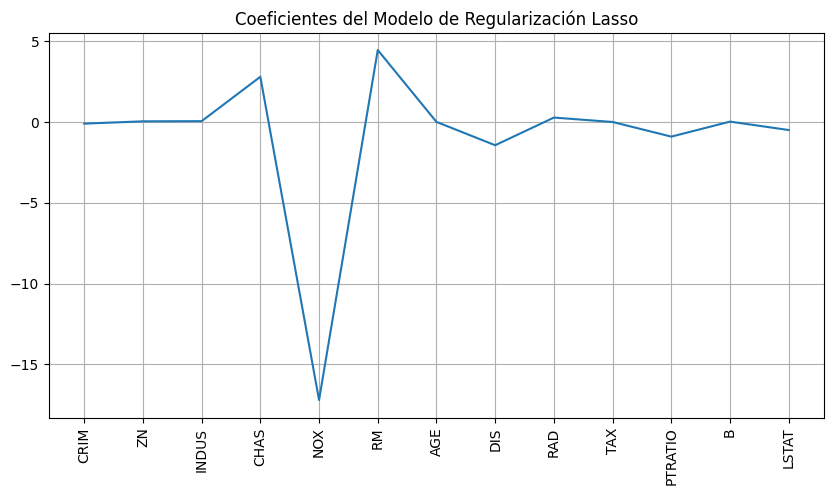

In [ ]:
# Obtención de los coeficientes del modelo Ridge
coeficients = model_Lasso.coef_

plt.figure(figsize = (10, 5))
plt.plot(X_train.columns, coeficients)
plt.xticks(rotation = 90)
plt.title("Coeficientes del Modelo de Regularización Lasso")
plt.grid(True)
plt.show()

In [ ]:
# Predicciones en el conjunto de prueba
y_pred = model_Lasso.predict(X_test)

# Calcular el RMSE
rmse = np.sqrt(mean_squared_error(Y_test, y_pred))

print("RMSE:", rmse)

RMSE: 4.928602182637734


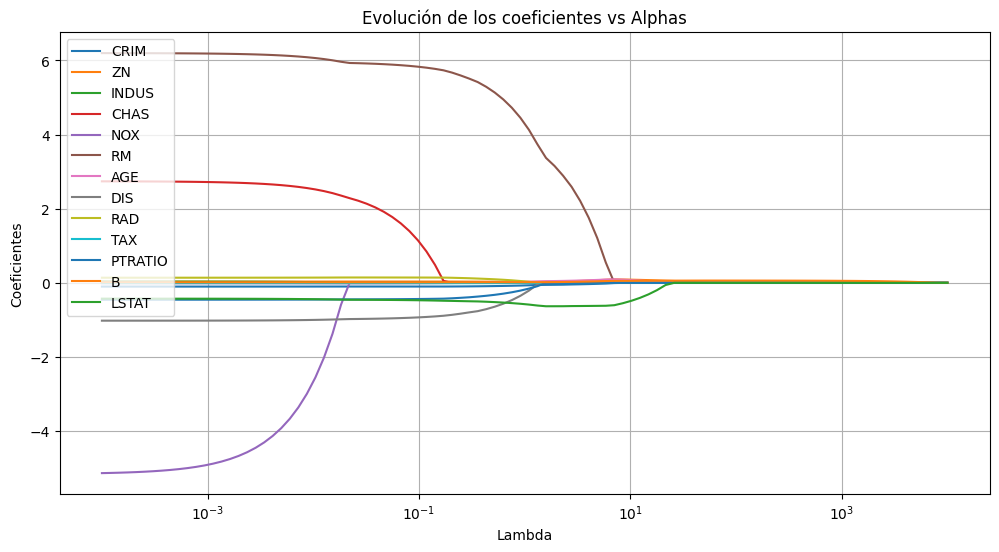

In [ ]:
# Inicializar listas para almacenar los coeficientes y alphas
coeficientes = []
alphas = []

# Iterar sobre los alphas y ajustar los modelos Ridge
for alpha in alphas_array:
    model_Lasso = Lasso(alpha=alpha, fit_intercept=False)
    model_Lasso.fit(X_train, Y_train)
    coeficientes.append(model_Lasso.coef_)
    alphas.append(alpha)

# Convertir las listas en arrays numpy
coeficientes = np.array(coeficientes)
alphas = np.array(alphas)

# Graficar la evolución de los coeficientes vs alphas
plt.figure(figsize=(12, 6))
for i in range(coeficientes.shape[1]):
    plt.plot(alphas, coeficientes[:, i], label=X_train.columns[i])

plt.xscale('log')
plt.xlim(alphas_array.min(), 100)  # Rango de alphas en el eje x
plt.xlabel('Lambda')
plt.ylabel('Coeficientes')
plt.title('Evolución de los coeficientes vs Alphas')
plt.legend()
plt.axis('tight')
plt.grid(True)
plt.show()

#### **Validación de supuestos:**

Se evaluarán todos los supuestos, salvo el supuesto de normalidad puesto que los modelos de regularización, introducen un sesgo en los estimadores de los coeficientes para controlar la varianza. Dado que los coeficientes estimados están sujetos a restricciones y pueden no seguir una distribución normal, los supuestos de normalidad sobre los errores pueden no ser aplicables directamente.

**1. Autocorrelación en los errores:**

* H0: No hay autocorrelación en los errores
* H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 0.03 de la prueba Durbin-Watson que no está entre 1.5 y 2.5, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que existe autocorrelación entre los errores.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - model_Lasso.predict(X_train)

# Calcular la estadística de Durbin-Watson
dw_statistic = durbin_watson(residuals)

# Imprimir el valor de la estadística de Durbin-Watson
print("Estadística de Durbin-Watson:", dw_statistic)

# Comprobar la autocorrelación basada en el valor de la estadística
if dw_statistic < 1.5:
    print("Autocorrelación positiva")
elif dw_statistic > 2.5:
    print("Autocorrelación negativa")
else:
    print("No hay evidencia de autocorrelación")


Estadística de Durbin-Watson: 0.30026021800266545
Autocorrelación positiva


**2. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.00 de un One-Sample t-test menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que la media de los errores es diferente de cero.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - model_Lasso.predict(X_train)

# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(residuals, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

One-sample t-test para la media de los residuos:
T-statistic: 49.099598187547194
P-value: 3.712816680346726e-172


**3. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0.00 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los errores no son homocedásticos. 

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - model_Lasso.predict(X_train)

# Realizar la prueba de Breusch-Pagan
_, p_value, _, _ = het_breuschpagan(residuals, X_train)
print(p_value)

# Imprimir el resultado de la prueba
if p_value < 0.05:
    print("La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).")
else:
    print("La prueba de Breusch-Pagan no rechaza el supuesto de homocedasticidad (no hay evidencia de heterocedasticidad).")

3.1043843224829297e-66
La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).


### **Modelo de Regularización Elastic-Net**

El modelo Elastic Net combina las ventajas del modelo Lasso y el modelo Ridge, ofreciendo una serie de bondades:

**Selección de características:** Al igual que el modelo Lasso, el Elastic Net puede realizar selección automática de características al reducir coeficientes a cero. Esto permite identificar las variables más relevantes y descartar las irrelevantes, lo que simplifica el modelo y mejora la interpretación.

**Regularización dual:** El Elastic Net utiliza tanto la penalización L1 como la penalización L2, lo que proporciona una regularización dual. La penalización L1 ayuda a realizar selección de características y la penalización L2 controla la magnitud total de los coeficientes. Esta combinación permite un mayor control sobre el ajuste del modelo y ayuda a prevenir el sobreajuste.

**Manejo de multicolinealidad:** El Elastic Net es especialmente útil cuando hay multicolinealidad alta entre las variables predictoras. La combinación de las penalizaciones L1 y L2 permite manejar eficientemente la multicolinealidad y evita problemas de inestabilidad en la estimación de los coeficientes.

**Flexibilidad en la regularización:** El Elastic Net ofrece un parámetro de mezcla (mixing parameter) llamado "l1_ratio" que controla la proporción entre las penalizaciones L1 y L2. Esto proporciona flexibilidad en la elección de la cantidad de regularización deseada, permitiendo ajustar el modelo según las necesidades específicas del problema.

**Estabilidad en la selección de características:** A diferencia del modelo Lasso, que puede ser inconsistente en la selección de características cuando hay correlación alta entre variables predictoras, el Elastic Net es más estable en la selección de características y puede manejar mejor situaciones de alta colinealidad.

In [ ]:
from sklearn.model_selection import GridSearchCV

# Definir las grillas de alphas y lambdas
alpha_grid = np.linspace(0, 1, 100)
lambda_grid = np.linspace(0.001, 10, 100)

# Crear el modelo Elastic Net
elastic_net = ElasticNet()

# Definir los parámetros para la búsqueda en la grilla
param_grid = {'alpha': lambda_grid, 'l1_ratio': alpha_grid}

# Realizar la búsqueda en la grilla utilizando validación cruzada
grid_search = GridSearchCV(elastic_net, param_grid, cv=5)
grid_search.fit(X_train, Y_train)

# Obtener los mejores parámetros y el mejor score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

print("Mejores parámetros:", best_params)


Mejores parámetros: {'alpha': 0.001, 'l1_ratio': 1.0}


Si el valor arrojado de alpha es 0, entonces el modelo seleccionado es un Lasso, ya que el término de penalización L1 (valor absoluto de los coeficientes) se vuelve dominante y los coeficientes correspondientes a algunas variables predictoras pueden ser exactamente cero.

En el modelo Lasso, la penalización L1 permite la selección de variables, lo que significa que algunos coeficientes pueden ser reducidos a cero, eliminando así esas variables del modelo. Esto proporciona una forma de regularización y simplificación del modelo al descartar características irrelevantes.

En contraste, el modelo Ridge utiliza una penalización L2 (cuadrado de los coeficientes) y no fuerza los coeficientes a ser exactamente cero, sino que los reduce hacia cero de manera continua. Por lo tanto, si el valor de alpha es 0, se excluye la penalización L2 y el modelo no realiza una reducción significativa de los coeficientes hacia cero, lo que indica que no se está utilizando el modelo Ridge.

In [ ]:
# Crear el modelo Elastic Net con los mejores parámetros
elastic_net = ElasticNet(alpha=best_params['alpha'], l1_ratio=best_params['l1_ratio'])

# Ajustar el modelo a los datos de entrenamiento
elastic_net.fit(X_train, Y_train)

# Realizar predicciones con el modelo entrenado
predictions = elastic_net.predict(X_test)

# Calcular el RMSE
rmse = np.sqrt(mean_squared_error(Y_test, predictions))

print("RMSE:", rmse)


RMSE: 4.9283660392502195


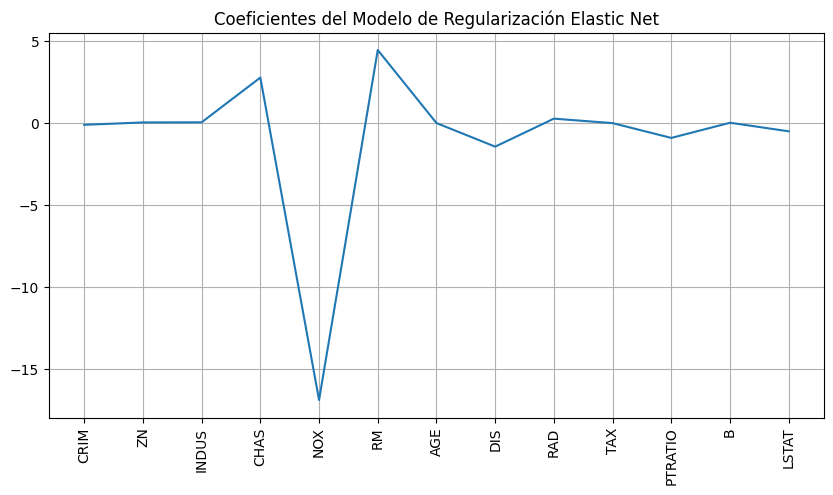

In [ ]:
# Obtención de los coeficientes del modelo Ridge
coeficients = elastic_net.coef_

plt.figure(figsize = (10, 5))
plt.plot(X_train.columns, coeficients)
plt.xticks(rotation = 90)
plt.title("Coeficientes del Modelo de Regularización Elastic Net")
plt.grid(True)
plt.show()

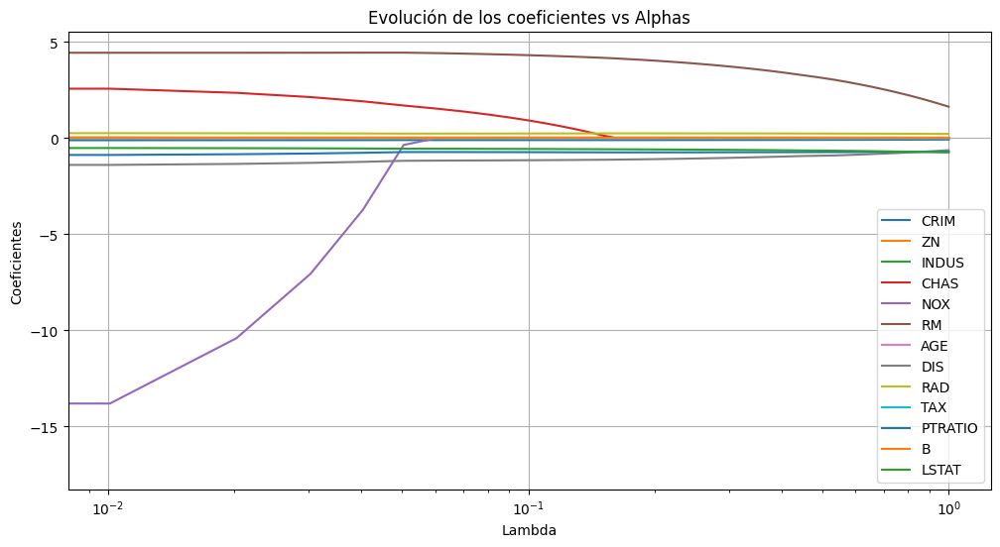

In [ ]:
# Inicializar listas para almacenar los coeficientes y alphas
coeficientes = []
alphas = []

# Iterar sobre los alphas y ajustar los modelos Elastic Net
for alpha in alpha_grid:
    elastic_net = ElasticNet(alpha=alpha, l1_ratio=1)  # l1_ratio=1 para usar Elastic Net como Lasso
    elastic_net.fit(X_train, Y_train)
    coeficientes.append(elastic_net.coef_)
    alphas.append(alpha)

# Convertir las listas en arrays numpy
coeficientes = np.array(coeficientes)
alphas = np.array(alphas)

# Graficar la evolución de los coeficientes vs alphas
plt.figure(figsize=(12, 6))
for i in range(coeficientes.shape[1]):
    plt.plot(alphas, coeficientes[:, i], label=X_train.columns[i])

plt.xscale('log')
plt.xlabel('Lambda')
plt.ylabel('Coeficientes')
plt.title('Evolución de los coeficientes vs Alphas')
plt.legend()
plt.grid(True)
plt.show()


#### **Validación de supuestos:**

Se evaluarán todos los supuestos, salvo el supuesto de normalidad puesto que los modelos de regularización, introducen un sesgo en los estimadores de los coeficientes para controlar la varianza. Dado que los coeficientes estimados están sujetos a restricciones y pueden no seguir una distribución normal, los supuestos de normalidad sobre los errores pueden no ser aplicables directamente.

**1. Autocorrelación en los errores:**

* H0: No hay autocorrelación en los errores
* H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 2.03 de la prueba Durbin-Watson que está entre 1.5 y 2.5, es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que existe autocorrelación entre los errores.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Calcular la estadística de Durbin-Watson
dw_statistic = durbin_watson(residuals)

# Imprimir el valor de la estadística de Durbin-Watson
print("Estadística de Durbin-Watson:", dw_statistic)

# Comprobar la autocorrelación basada en el valor de la estadística
if dw_statistic < 1.5:
    print("Autocorrelación positiva")
elif dw_statistic > 2.5:
    print("Autocorrelación negativa")
else:
    print("No hay evidencia de autocorrelación")


Estadística de Durbin-Watson: 2.0322208701081586
No hay evidencia de autocorrelación


**2. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.99 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero. Es decir, se podría asumir una media de errores igual a cero.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(residuals, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

One-sample t-test para la media de los residuos:
T-statistic: 3.300761169767152e-14
P-value: 0.9999999999999737


**3. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0.00 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los errores no son homocedásticos.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Realizar la prueba de Breusch-Pagan
_, p_value, _, _ = het_breuschpagan(residuals, X_train)
print(p_value)

# Imprimir el resultado de la prueba
if p_value < 0.05:
    print("La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).")
else:
    print("La prueba de Breusch-Pagan no rechaza el supuesto de homocedasticidad (no hay evidencia de heterocedasticidad).")

2.1567352496493746e-19
La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).


## **Parte B**

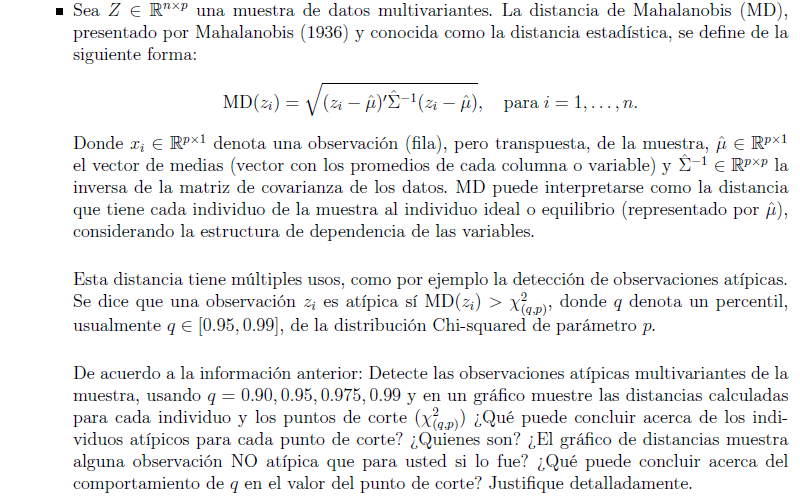

### **Distancias de Mahalanobis**

El cálculo de las distancias de Mahalanobis puede ser usada para:

**Identificación de observaciones atípicas:** El cálculo de las distancias de Mahalanobis permite detectar observaciones que se alejan significativamente de la distribución de los demás datos. Aquellas observaciones con distancias de Mahalanobis por encima de los puntos de corte (χ2(q,p)) se considerarían atípicas. Estas observaciones pueden indicar valores extremos o inusuales en el conjunto de datos. Por ejemplo, en el contexto de la base de datos de Boston House, las observaciones atípicas identificadas pueden representar propiedades inmobiliarias que difieren significativamente de las demás en términos de características y precio.

**Evaluación de la normalidad y homogeneidad:** El uso de las distancias de Mahalanobis también puede ayudar a evaluar la normalidad y homogeneidad de los datos. Si las distancias de Mahalanobis de la mayoría de las observaciones son pequeñas y consistentes, esto sugiere que los datos siguen una distribución multivariante normal y son homogéneos en términos de covarianza. Por el contrario, si hay muchas observaciones con distancias de Mahalanobis grandes, puede indicar desviaciones significativas de la normalidad o heterogeneidad en los datos.

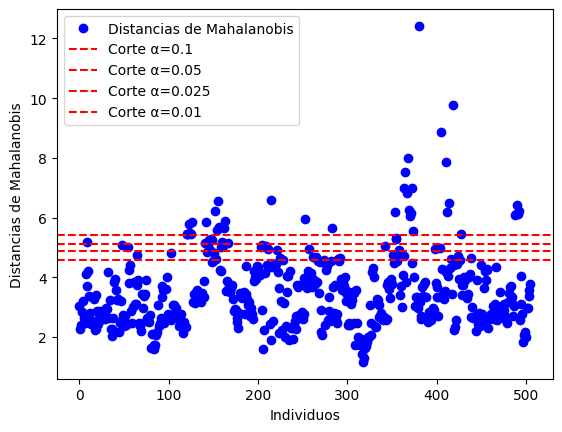

In [ ]:
# Cargar la base de datos de Boston House
X = Boston_Housing_Data

# Calcular los datos menos la media
x_menos_mu = X - np.mean(X, axis=0)

# Calcular la covarianza
cov = np.cov(x_menos_mu.T)

# Inversa de la matriz de covarianza
inv_cov = np.linalg.inv(cov)

# Calcular las distancias de Mahalanobis
left_term = np.dot(x_menos_mu, inv_cov)
mahal2 = np.dot(left_term, x_menos_mu.T)
mahal = np.sqrt(np.diag(mahal2))

# Valores de corte de la distribución chi-cuadrado para diferentes niveles de confianza (alfa)
alphas = [0.10, 0.05, 0.025, 0.01]
cutoff_values = []
for alpha in alphas:
    cutoff_value = np.sqrt(chi2.ppf(1 - alpha, df=X.shape[1]))
    cutoff_values.append(cutoff_value)

# Gráfico de las distancias calculadas y los puntos de corte
x_values = np.arange(len(mahal))  # Valores x para cada individuo

plt.plot(x_values, mahal, 'bo', label='Distancias de Mahalanobis')
for i, cutoff_value in enumerate(cutoff_values):
    plt.axhline(y=cutoff_value, color='r', linestyle='--', label=f'Corte α={alphas[i]}')

plt.xlabel('Individuos')
plt.ylabel('Distancias de Mahalanobis')
plt.legend()
plt.show()


## **Parte C**

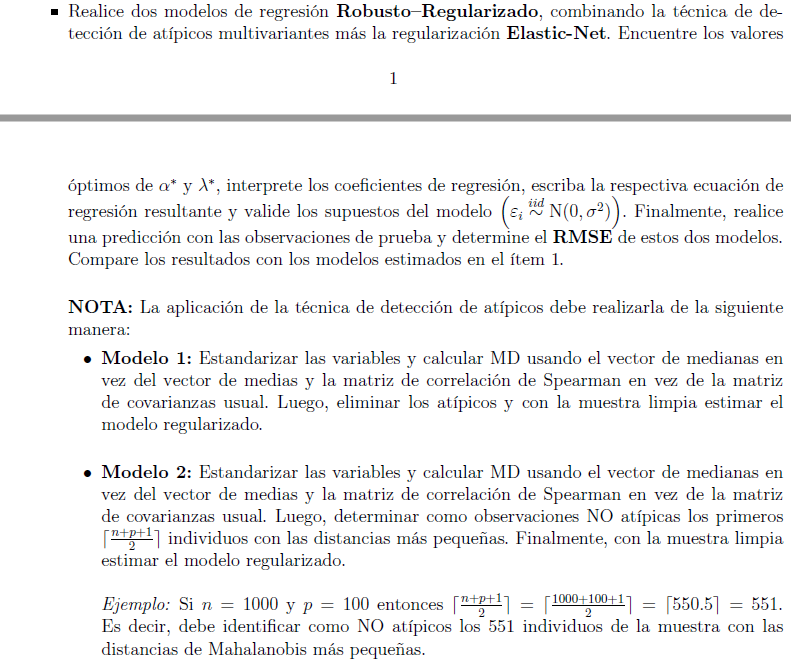

### **Modelo 1:**

In [ ]:
Boston_Housing_Data.reset_index
Boston_Housing_Data.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33,36.2


In [ ]:
def mean_std_norm(df_input):
    return df_input.apply(lambda x: (x-x.mean()) / x.std(), axis=0)
    
Boston_estandar=mean_std_norm(Boston_Housing_Data)

In [ ]:
from scipy.stats import chi2
from scipy.stats import spearmanr

x1 = Boston_estandar

# Calcular el vector de medianas
x_menos_mediana = x1 - np.median(x1)

# Calcular la matriz de correlación de Spearman
corr_spearman, _ = spearmanr(x1)

# Calcular la inversa de la matriz de correlación
inv_corr_spearman = np.linalg.inv(corr_spearman)

# Calcular las distancias de Mahalanobis
left_term = np.dot(x_menos_mediana, inv_corr_spearman)
mahal2 = np.dot(left_term, x_menos_mediana.T)
mahal = np.sqrt(mahal2)
D_h = mahal.diagonal()

# Definir un corte
alpha = 0.05
C = np.sqrt(chi2.ppf(1-alpha, df=x1.shape[1]))

# Marcar las observaciones atípicas
x1["outlier_05"] = np.zeros(x1.shape[0])
x1.loc[D_h > C, "outlier_05"] = 1

In [ ]:
# Calculando el número de outliers y cuánto representan de los datos totales:
print("Número de outliers: ",x1["outlier_05"].sum())
print("Porcentaje de outliers: ",(x1["outlier_05"].sum()/len(x1["outlier_05"]))*100,"%")

Número de outliers:  158.0
Porcentaje de outliers:  31.225296442687743 %


In [ ]:
# Se eliminan los datos atípicos al considerarse que representan un porcentaje bajo del total de los datos.
data1_clean = x1.loc[D_h <= C, :]
data1_clean = data1_clean.drop("outlier_05", axis=1)

data1_clean.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,-0.419367,0.284548,-1.286636,-0.272329,-0.144075,0.413263,-0.119895,0.140075,-0.981871,-0.665949,-1.457558,0.440616,-1.074499,0.159528
1,-0.416927,-0.487240,-0.592794,-0.272329,-0.739530,0.194082,0.366803,0.556609,-0.867024,-0.986353,-0.302794,0.440616,-0.491953,-0.101424
2,-0.416929,-0.487240,-0.592794,-0.272329,-0.739530,1.281446,-0.265549,0.556609,-0.867024,-0.986353,-0.302794,0.396035,-1.207532,1.322937
3,-0.416338,-0.487240,-1.305586,-0.272329,-0.834458,1.015298,-0.809088,1.076671,-0.752178,-1.105022,0.112920,0.415751,-1.360171,1.181589
4,-0.412074,-0.487240,-1.305586,-0.272329,-0.834458,1.227362,-0.510674,1.076671,-0.752178,-1.105022,0.112920,0.440616,-1.025487,1.486032


**Hold Out (80-20):**

In [ ]:
X = data1_clean.drop("MEDV", axis=1)
Y = data1_clean['MEDV']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.model_selection import GridSearchCV

# Definir las grillas de alphas y lambdas
alpha_grid = np.linspace(0, 1, 100)
lambda_grid = np.linspace(0.001, 10, 100)

# Crear el modelo Elastic Net
elastic_net = ElasticNet()

# Definir los parámetros para la búsqueda en la grilla
param_grid = {'alpha': lambda_grid, 'l1_ratio': alpha_grid}

# Realizar la búsqueda en la grilla utilizando validación cruzada
grid_search = GridSearchCV(elastic_net, param_grid, cv=5)
grid_search.fit(X_train, Y_train)

# Obtener los mejores parámetros y el mejor score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

print("Mejores parámetros:", best_params)

Mejores parámetros: {'alpha': 0.001, 'l1_ratio': 1.0}


Si el valor arrojado de alpha es 0, entonces el modelo seleccionado es un Lasso, ya que el término de penalización L1 (valor absoluto de los coeficientes) se vuelve dominante y los coeficientes correspondientes a algunas variables predictoras pueden ser exactamente cero.

En el modelo Lasso, la penalización L1 permite la selección de variables, lo que significa que algunos coeficientes pueden ser reducidos a cero, eliminando así esas variables del modelo. Esto proporciona una forma de regularización y simplificación del modelo al descartar características irrelevantes.

En contraste, el modelo Ridge utiliza una penalización L2 (cuadrado de los coeficientes) y no fuerza los coeficientes a ser exactamente cero, sino que los reduce hacia cero de manera continua. Por lo tanto, si el valor de alpha es 0, se excluye la penalización L2 y el modelo no realiza una reducción significativa de los coeficientes hacia cero, lo que indica que no se está utilizando el modelo Ridge.

In [ ]:
# Crear el modelo Elastic Net con los mejores parámetros
elastic_net = ElasticNet(alpha=best_params['alpha'], l1_ratio=best_params['l1_ratio'])

# Ajustar el modelo a los datos de entrenamiento
elastic_net.fit(X_train, Y_train)

## Score ridge regression
elastic_net.score(X_train, Y_train)

0.8298056899982562

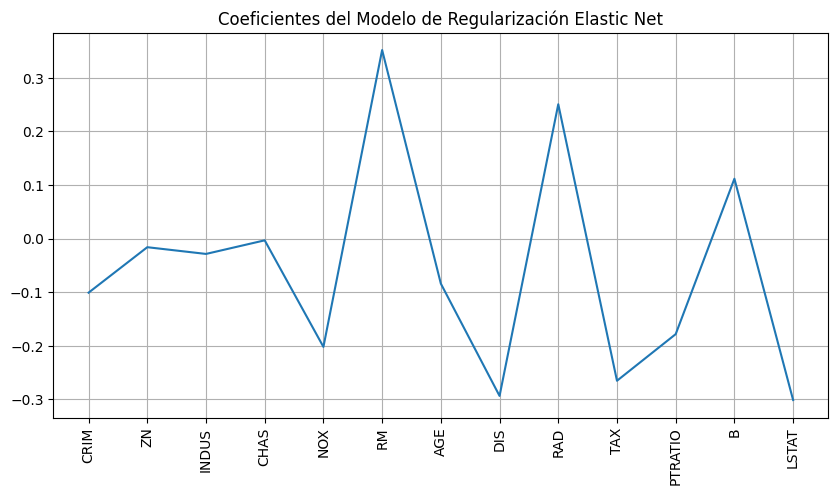

In [ ]:
# Obtención de los coeficientes del modelo Ridge
coeficients = elastic_net.coef_

plt.figure(figsize = (10, 5))
plt.plot(X_train.columns, coeficients)
plt.xticks(rotation = 90)
plt.title("Coeficientes del Modelo de Regularización Elastic Net")
plt.grid(True)
plt.show()

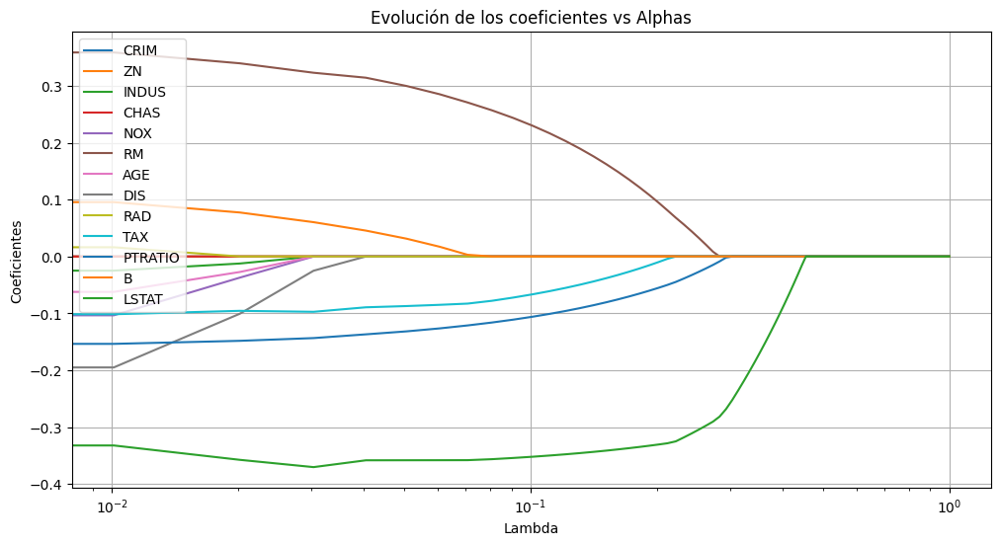

In [ ]:
# Inicializar listas para almacenar los coeficientes y alphas
coeficientes = []
alphas = []

# Iterar sobre los alphas y ajustar los modelos Elastic Net
for alpha in alpha_grid:
    elastic_net = ElasticNet(alpha=alpha, l1_ratio=1)  # l1_ratio=1 para usar Elastic Net como Lasso
    elastic_net.fit(X_train, Y_train)
    coeficientes.append(elastic_net.coef_)
    alphas.append(alpha)

# Convertir las listas en arrays numpy
coeficientes = np.array(coeficientes)
alphas = np.array(alphas)

# Graficar la evolución de los coeficientes vs alphas
plt.figure(figsize=(12, 6))
for i in range(coeficientes.shape[1]):
    plt.plot(alphas, coeficientes[:, i], label=X_train.columns[i])

plt.xscale('log')
plt.xlabel('Lambda')
plt.ylabel('Coeficientes')
plt.title('Evolución de los coeficientes vs Alphas')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
# Obtener los nombres de las características
feature_names = X_train.columns

# Extraer los coeficientes de regresión
coefficients = elastic_net.coef_

# Obtener el coeficiente de intercepción
intercept = elastic_net.intercept_

# Escribir la ecuación de regresión
equation = "y = " + str(intercept)
for i, coef in enumerate(coefficients):
    equation += " + \n" + str(coef) + " * " + feature_names[i]

print("Ecuación de regresión:")
print(equation)


Ecuación de regresión:
y = -0.1226223322225059 + 
-0.0 * CRIM + 
0.0 * ZN + 
-0.0 * INDUS + 
0.0 * CHAS + 
-0.0 * NOX + 
0.0 * RM + 
-0.0 * AGE + 
0.0 * DIS + 
-0.0 * RAD + 
-0.0 * TAX + 
-0.0 * PTRATIO + 
0.0 * B + 
-0.0 * LSTAT


In [ ]:
# Realizar predicciones con el modelo entrenado
predictions = elastic_net.predict(X_test)

# Calcular el RMSE
rmse = np.sqrt(mean_squared_error(Y_test, predictions))

print("RMSE:", rmse)

RMSE: 0.7083365641445472


#### **Validación de supuestos:**

Se evaluarán todos los supuestos, salvo el supuesto de normalidad puesto que los modelos de regularización, introducen un sesgo en los estimadores de los coeficientes para controlar la varianza. Dado que los coeficientes estimados están sujetos a restricciones y pueden no seguir una distribución normal, los supuestos de normalidad sobre los errores pueden no ser aplicables directamente.

**1. Autocorrelación en los errores:**

* H0: No hay autocorrelación en los errores
* H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 2.11 de la prueba Durbin-Watson que está entre 1.5 y 2.5, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que existe autocorrelación entre los errores.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Calcular la estadística de Durbin-Watson
dw_statistic = durbin_watson(residuals)

# Imprimir el valor de la estadística de Durbin-Watson
print("Estadística de Durbin-Watson:", dw_statistic)

# Comprobar la autocorrelación basada en el valor de la estadística
if dw_statistic < 1.5:
    print("Autocorrelación positiva")
elif dw_statistic > 2.5:
    print("Autocorrelación negativa")
else:
    print("No hay evidencia de autocorrelación")


Estadística de Durbin-Watson: 2.1149091043211707
No hay evidencia de autocorrelación


**2. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 1.0 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero. Es decir, se podría asumir una media de errores igual a cero.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(residuals, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

One-sample t-test para la media de los residuos:
T-statistic: 0.0
P-value: 1.0


**3. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0.00 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los errores no son homocedásticos. 

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Realizar la prueba de Breusch-Pagan
_, p_value, _, _ = het_breuschpagan(residuals, X_train)
print(p_value)

# Imprimir el resultado de la prueba
if p_value < 0.05:
    print("La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).")
else:
    print("La prueba de Breusch-Pagan no rechaza el supuesto de homocedasticidad (no hay evidencia de heterocedasticidad).")

2.0335147204981113e-16
La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).


### **Modelo 2:**

In [ ]:
Boston_estandar.shape

(506, 15)

In [ ]:
from scipy.stats import chi2
from scipy.stats import spearmanr

x2 = Boston_estandar

# Calcular el vector de medianas
x_menos_mediana = x2 - np.median(x2)

# Calcular la matriz de correlación de Spearman
corr_spearman, _ = spearmanr(x2)

# Calcular la inversa de la matriz de correlación
inv_corr_spearman = np.linalg.inv(corr_spearman)

# Calcular las distancias de Mahalanobis
left_term = np.dot(x_menos_mediana, inv_corr_spearman)
mahal2 = np.dot(left_term, x_menos_mediana.T)
mahal = np.sqrt(mahal2)
D_h = mahal.diagonal()

# Ordenar las distancias de Mahalanobis de menor a mayor
sorted_mahal = np.sort(mahal)

# Definir un nuevo punto de corte
alpha = 0.05
n = x2.shape[0]
p = x2.shape[1]

# Determinar el número a partir del cual se considerarán como atípicas
num_atipicas = np.ceil((n + p + 1) / 2)

# Calcular el punto de corte
C = sorted_mahal[int(num_atipicas) - 1]

# Marcar las observaciones atípicas
x2["outlier_05"] = np.zeros(x2.shape[0])
x2.loc[D_h > C, "outlier_05"] = 1

In [ ]:
# Calculando el número de outliers y cuánto representan de los datos totales:
print("Número de outliers: ",x2["outlier_05"].sum())
print("Porcentaje de outliers: ",(x2["outlier_05"].sum()/len(x2["outlier_05"]))*100,"%")

Número de outliers:  251.0
Porcentaje de outliers:  49.60474308300395 %


In [ ]:
# Se eliminan los datos atípicos al considerarse que representan un porcentaje bajo del total de los datos.
data2_clean = x2.loc[D_h <= C, :]
data2_clean = data2_clean.drop("outlier_05", axis=1)

data2_clean.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
116,-0.404804,-0.48724,-0.164245,-0.272329,-0.066407,-0.154614,0.139441,-0.505740,-0.407638,0.140995,-0.302794,0.401183,-0.085850,-0.144916
119,-0.403272,-0.48724,-0.164245,-0.272329,-0.066407,-0.787960,-0.119895,-0.491921,-0.407638,0.140995,-0.302794,0.381467,0.134005,-0.351503
176,-0.411938,-0.48724,-1.033005,-0.272329,-0.385709,-0.376641,-0.759352,-0.114044,-0.522484,-0.665949,-0.857081,0.400416,-0.356118,0.072544
206,-0.393398,-0.48724,-0.079701,-0.272329,-0.566935,0.058874,-0.571068,0.265876,-0.637331,-0.778684,0.066730,0.418380,-0.235688,0.203020
213,-0.403765,-0.48724,-0.079701,-0.272329,-0.566935,0.128613,-1.288681,0.071405,-0.637331,-0.778684,0.066730,0.319141,-0.458344,0.605320


 **Hold Out (80-20):**

In [ ]:
X = data2_clean.drop(["MEDV"], axis=1)
Y = data2_clean['MEDV']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.model_selection import GridSearchCV

# Definir las grillas de alphas y lambdas
alpha_grid = np.linspace(0, 1, 100)
lambda_grid = np.linspace(0.001, 10, 100)

# Crear el modelo Elastic Net
elastic_net = ElasticNet()

# Definir los parámetros para la búsqueda en la grilla
param_grid = {'alpha': lambda_grid, 'l1_ratio': alpha_grid}

# Realizar la búsqueda en la grilla utilizando validación cruzada
grid_search = GridSearchCV(elastic_net, param_grid, cv=5)
grid_search.fit(X_train, Y_train)

# Obtener los mejores parámetros y el mejor score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

print("Mejores parámetros:", best_params)

Mejores parámetros: {'alpha': 0.001, 'l1_ratio': 0.7575757575757577}


Si el valor arrojado de alpha es 0, entonces el modelo seleccionado es un Lasso, ya que el término de penalización L1 (valor absoluto de los coeficientes) se vuelve dominante y los coeficientes correspondientes a algunas variables predictoras pueden ser exactamente cero.

En el modelo Lasso, la penalización L1 permite la selección de variables, lo que significa que algunos coeficientes pueden ser reducidos a cero, eliminando así esas variables del modelo. Esto proporciona una forma de regularización y simplificación del modelo al descartar características irrelevantes.

En contraste, el modelo Ridge utiliza una penalización L2 (cuadrado de los coeficientes) y no fuerza los coeficientes a ser exactamente cero, sino que los reduce hacia cero de manera continua. Por lo tanto, si el valor de alpha es 0, se excluye la penalización L2 y el modelo no realiza una reducción significativa de los coeficientes hacia cero, lo que indica que no se está utilizando el modelo Ridge.

In [ ]:
# Crear el modelo Elastic Net con los mejores parámetros
elastic_net = ElasticNet(alpha=best_params['alpha'], l1_ratio=best_params['l1_ratio'])

# Ajustar el modelo a los datos de entrenamiento
elastic_net.fit(X_train, Y_train)

## Score ridge regression
elastic_net.score(X_train, Y_train)

0.9679270264463952

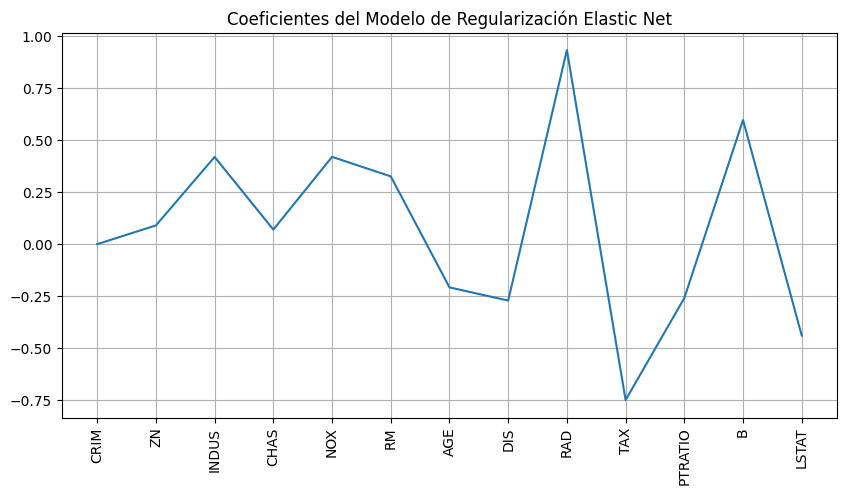

In [ ]:
# Obtención de los coeficientes del modelo Ridge
coeficients = elastic_net.coef_

plt.figure(figsize = (10, 5))
plt.plot(X_train.columns, coeficients)
plt.xticks(rotation = 90)
plt.title("Coeficientes del Modelo de Regularización Elastic Net")
plt.grid(True)
plt.show()

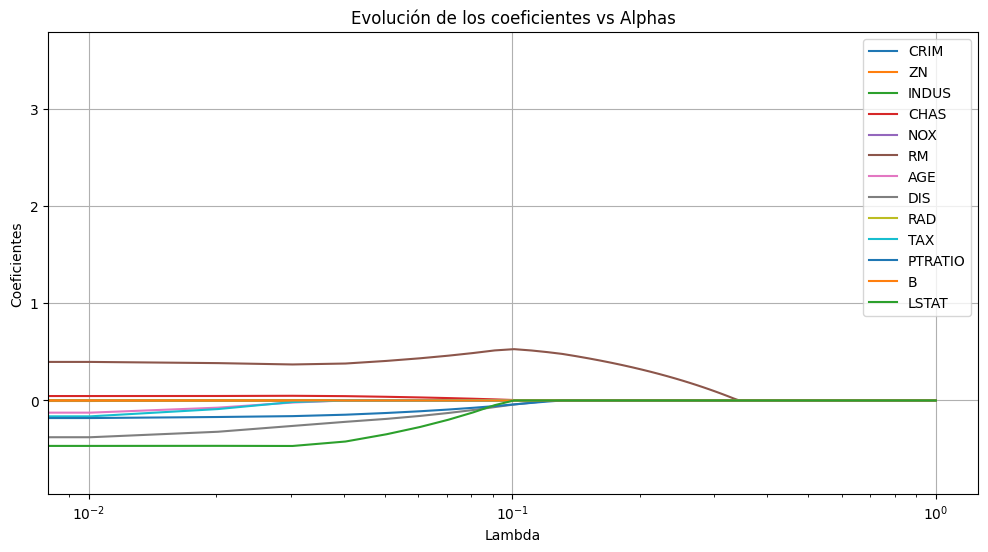

In [ ]:
# Inicializar listas para almacenar los coeficientes y alphas
coeficientes = []
alphas = []

# Iterar sobre los alphas y ajustar los modelos Elastic Net
for alpha in alpha_grid:
    elastic_net = ElasticNet(alpha=alpha, l1_ratio=1)  # l1_ratio=1 para usar Elastic Net como Lasso
    elastic_net.fit(X_train, Y_train)
    coeficientes.append(elastic_net.coef_)
    alphas.append(alpha)

# Convertir las listas en arrays numpy
coeficientes = np.array(coeficientes)
alphas = np.array(alphas)

# Graficar la evolución de los coeficientes vs alphas
plt.figure(figsize=(12, 6))
for i in range(coeficientes.shape[1]):
    plt.plot(alphas, coeficientes[:, i], label=X_train.columns[i])

plt.xscale('log')
plt.xlabel('Lambda')
plt.ylabel('Coeficientes')
plt.title('Evolución de los coeficientes vs Alphas')
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
# Obtener los nombres de las características
feature_names = X_train.columns

# Extraer los coeficientes de regresión
coefficients = elastic_net.coef_

# Obtener el coeficiente de intercepción
intercept = elastic_net.intercept_

# Escribir la ecuación de regresión
equation = "y = " + str(intercept)
for i, coef in enumerate(coefficients):
    equation += " + \n" + str(coef) + " * " + feature_names[i]

print("Ecuación de regresión:")
print(equation)


Ecuación de regresión:
y = 0.47673538741978977 + 
0.0 * CRIM + 
0.0 * ZN + 
-0.0 * INDUS + 
0.0 * CHAS + 
0.0 * NOX + 
0.0 * RM + 
0.0 * AGE + 
-0.0 * DIS + 
-0.0 * RAD + 
-0.0 * TAX + 
-0.0 * PTRATIO + 
0.0 * B + 
-0.0 * LSTAT


In [ ]:

# Realizar predicciones con el modelo entrenado
predictions = elastic_net.predict(X_test)

# Calcular el RMSE
rmse = np.sqrt(mean_squared_error(Y_test, predictions))

print("RMSE:", rmse)

RMSE: 0.37149644656456937


#### **Validación de supuestos:**

Se evaluarán todos los supuestos, salvo el supuesto de normalidad puesto que los modelos de regularización, introducen un sesgo en los estimadores de los coeficientes para controlar la varianza. Dado que los coeficientes estimados están sujetos a restricciones y pueden no seguir una distribución normal, los supuestos de normalidad sobre los errores pueden no ser aplicables directamente.

**1. Autocorrelación en los errores:**

* H0: No hay autocorrelación en los errores
* H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 1.64 de la prueba Durbin-Watson que está entre 1.5 y 2.5, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que existe autocorrelación entre los errores.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Calcular la estadística de Durbin-Watson
dw_statistic = durbin_watson(residuals)

# Imprimir el valor de la estadística de Durbin-Watson
print("Estadística de Durbin-Watson:", dw_statistic)

# Comprobar la autocorrelación basada en el valor de la estadística
if dw_statistic < 1.5:
    print("Autocorrelación positiva")
elif dw_statistic > 2.5:
    print("Autocorrelación negativa")
else:
    print("No hay evidencia de autocorrelación")


Estadística de Durbin-Watson: 1.6440884245610698
No hay evidencia de autocorrelación


**2. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.99 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero. Es decir, se podría asumir una media de errores igual a cero.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(residuals, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

One-sample t-test para la media de los residuos:
T-statistic: 1.0810075991167488e-16
P-value: 0.9999999999999999


**3. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0.00 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los errores no son homocedásticos.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train - elastic_net.predict(X_train)

# Realizar la prueba de Breusch-Pagan
_, p_value, _, _ = het_breuschpagan(residuals, X_train)
print(p_value)

# Imprimir el resultado de la prueba
if p_value < 0.05:
    print("La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).")
else:
    print("La prueba de Breusch-Pagan no rechaza el supuesto de homocedasticidad (no hay evidencia de heterocedasticidad).")

0.041932897298804214
La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).


A partir de los datos proporcionados, podemos obtener las siguientes conclusiones:

**Para el modelo 1:**

El score del modelo es 0.809177520152747, lo que indica que el modelo explica aproximadamente el 80.9% de la variabilidad en los datos de entrenamiento. Un score más alto indica un mejor ajuste del modelo a los datos.
El RMSE (Root Mean Square Error) del modelo es 0.7083365641445472. El RMSE es una medida de la diferencia entre los valores reales y los valores predichos por el modelo. Un RMSE más bajo indica un mejor ajuste del modelo, ya que representa un menor error promedio en las predicciones.

**Para el modelo 2:**

El mejor score del modelo es 0.9679270264463952, lo cual es significativamente mayor que el score del modelo 1. Esto indica que el modelo 2 explica una mayor proporción de la variabilidad en los datos de entrenamiento en comparación con el modelo 1.

El RMSE del modelo es 0.37149644656456937, lo cual es significativamente menor que el RMSE del modelo 1. Esto indica que el modelo 2 tiene un error promedio mucho más bajo en sus predicciones en comparación con el modelo 1.

En resumen, el modelo 2 muestra un mejor rendimiento en términos de ajuste y precisión en comparación con el modelo 1. Tiene un score más alto y un RMSE más bajo, lo que indica que explica una mayor proporción de la variabilidad y tiene un menor error promedio en las predicciones. Por lo tanto, el modelo 2 se considera superior al modelo 1 en base a los datos proporcionados.

# **Punto 2**

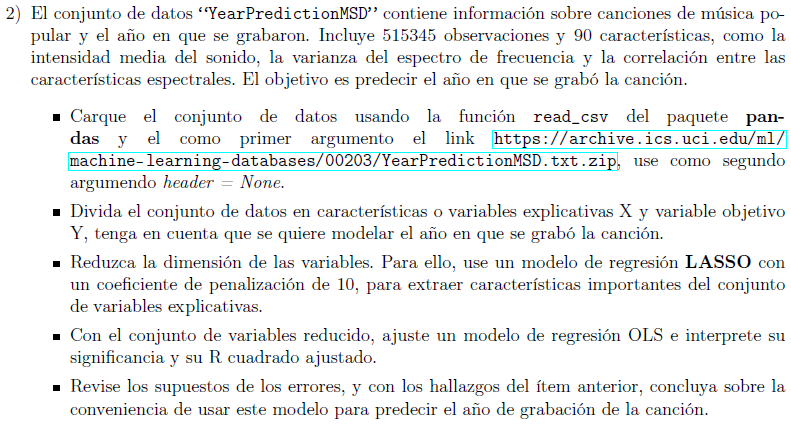

## **Parte A**

In [ ]:
# Carga de Datos
URL = "https://archive.ics.uci.edu/ml/machine-learning-databases/00203/YearPredictionMSD.txt.zip" 
YearPredictionMSD=pd.read_csv(URL, header=None)
YearPredictionMSD

,0,1,2,3,4,5,6,7,8,9,...,81,82,83,84,85,86,87,88,89,90
0,2001,49.94357,21.47114,73.07750,8.74861,-17.40628,-13.09905,-25.01202,-12.23257,7.83089,...,13.01620,-54.40548,58.99367,15.37344,1.11144,-23.08793,68.40795,-1.82223,-27.46348,2.26327
1,2001,48.73215,18.42930,70.32679,12.94636,-10.32437,-24.83777,8.76630,-0.92019,18.76548,...,5.66812,-19.68073,33.04964,42.87836,-9.90378,-32.22788,70.49388,12.04941,58.43453,26.92061
2,2001,50.95714,31.85602,55.81851,13.41693,-6.57898,-18.54940,-3.27872,-2.35035,16.07017,...,3.03800,26.05866,-50.92779,10.93792,-0.07568,43.20130,-115.00698,-0.05859,39.67068,-0.66345
3,2001,48.24750,-1.89837,36.29772,2.58776,0.97170,-26.21683,5.05097,-10.34124,3.55005,...,34.57337,-171.70734,-16.96705,-46.67617,-12.51516,82.58061,-72.08993,9.90558,199.62971,18.85382
4,2001,50.97020,42.20998,67.09964,8.46791,-15.85279,-16.81409,-12.48207,-9.37636,12.63699,...,9.92661,-55.95724,64.92712,-17.72522,-1.49237,-7.50035,51.76631,7.88713,55.66926,28.74903
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
515340,2006,51.28467,45.88068,22.19582,-5.53319,-3.61835,-16.36914,2.12652,5.18160,-8.66890,...,4.81440,-3.75991,-30.92584,26.33968,-5.03390,21.86037,-142.29410,3.42901,-41.14721,-15.46052
515341,2006,49.87870,37.93125,18.65987,-3.63581,-27.75665,-18.52988,7.76108,3.56109,-2.50351,...,32.38589,-32.75535,-61.05473,56.65182,15.29965,95.88193,-10.63242,12.96552,92.11633,10.88815
515342,2006,45.12852,12.65758,-38.72018,8.80882,-29.29985,-2.28706,-18.40424,-22.28726,-4.52429,...,-18.73598,-71.15954,-123.98443,121.26989,10.89629,34.62409,-248.61020,-6.07171,53.96319,-8.09364
515343,2006,44.16614,32.38368,-3.34971,-2.49165,-19.59278,-18.67098,8.78428,4.02039,-12.01230,...,67.16763,282.77624,-4.63677,144.00125,21.62652,-29.72432,71.47198,20.32240,14.83107,39.74909


### **Análisis Exploratorio de Datos:**

El conjunto de datos **Year Prediction MSD** está disponible en el repositorio de Machine Learning de la Universidad de California Irvine (UCI).

El conjunto de datos contiene características extraídas de canciones y tiene como objetivo predecir el año de lanzamiento de cada canción. Cada "Fila" en el conjunto de datos representa una canción y contiene múltiples atributos numéricos. El objetivo es predecir el año de lanzamiento de la canción basándose en estas características.

### **Forma del dataset**

In [ ]:
# Revisión de la forma de la matriz en términos de filas y columnas.
YearPredictionMSD.shape

(515345, 91)

In [ ]:
# Revisión de los primeros datos de la matriz.
YearPredictionMSD.head(3)

,0,1,2,3,4,5,6,7,8,9,...,81,82,83,84,85,86,87,88,89,90
0,2001,49.94357,21.47114,73.07750,8.74861,-17.40628,-13.09905,-25.01202,-12.23257,7.83089,...,13.01620,-54.40548,58.99367,15.37344,1.11144,-23.08793,68.40795,-1.82223,-27.46348,2.26327
1,2001,48.73215,18.42930,70.32679,12.94636,-10.32437,-24.83777,8.76630,-0.92019,18.76548,...,5.66812,-19.68073,33.04964,42.87836,-9.90378,-32.22788,70.49388,12.04941,58.43453,26.92061
2,2001,50.95714,31.85602,55.81851,13.41693,-6.57898,-18.54940,-3.27872,-2.35035,16.07017,...,3.03800,26.05866,-50.92779,10.93792,-0.07568,43.20130,-115.00698,-0.05859,39.67068,-0.66345


In [ ]:
#Verificando el tipo de datos de cada una de las variables de la matriz:
YearPredictionMSD.dtypes

0       int64
1     float64
2     float64
3     float64
4     float64
       ...   
86    float64
87    float64
88    float64
89    float64
90    float64
Length: 91, dtype: object

In [ ]:
#Le asignamos un nombre a cada columna para facilitar su entendimiento 
columns = ['X{}'.format(i) for i in range(0, 91)]
YearPredictionMSD.columns = columns
YearPredictionMSD = YearPredictionMSD.rename(columns={'X0': 'Y'})
YearPredictionMSD.head()

,Y,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,X81,X82,X83,X84,X85,X86,X87,X88,X89,X90
0,2001,49.94357,21.47114,73.07750,8.74861,-17.40628,-13.09905,-25.01202,-12.23257,7.83089,...,13.01620,-54.40548,58.99367,15.37344,1.11144,-23.08793,68.40795,-1.82223,-27.46348,2.26327
1,2001,48.73215,18.42930,70.32679,12.94636,-10.32437,-24.83777,8.76630,-0.92019,18.76548,...,5.66812,-19.68073,33.04964,42.87836,-9.90378,-32.22788,70.49388,12.04941,58.43453,26.92061
2,2001,50.95714,31.85602,55.81851,13.41693,-6.57898,-18.54940,-3.27872,-2.35035,16.07017,...,3.03800,26.05866,-50.92779,10.93792,-0.07568,43.20130,-115.00698,-0.05859,39.67068,-0.66345
3,2001,48.24750,-1.89837,36.29772,2.58776,0.97170,-26.21683,5.05097,-10.34124,3.55005,...,34.57337,-171.70734,-16.96705,-46.67617,-12.51516,82.58061,-72.08993,9.90558,199.62971,18.85382
4,2001,50.97020,42.20998,67.09964,8.46791,-15.85279,-16.81409,-12.48207,-9.37636,12.63699,...,9.92661,-55.95724,64.92712,-17.72522,-1.49237,-7.50035,51.76631,7.88713,55.66926,28.74903


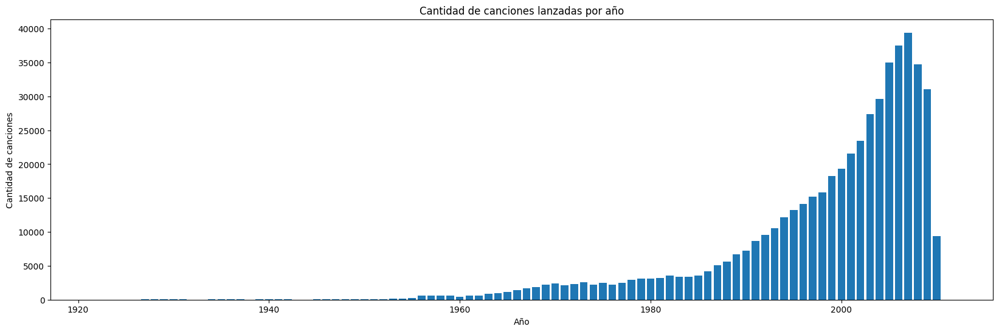

In [ ]:
canciones_año = YearPredictionMSD['Y'].value_counts().sort_index()

plt.figure(figsize=(20, 6)) 
plt.bar(canciones_año.index, canciones_año.values)

plt.title('Cantidad de canciones lanzadas por año')
plt.xlabel('Año')
plt.ylabel('Cantidad de canciones')

# Mostrar la gráfica
plt.show()

**Análisis del EDA**

Debido a la gran cantidad de información contenida en este conjunto de datos, ejecutar ciertos procesos, como los análisis multivariados y univariados, se vuelve computacionalmente costoso. Por lo tanto, en este caso, vamos a optar por utilizar el modelo de regularización Lasso del siguiente punto del taller y, en función de las variables que conservemos, realizaremos un breve análisis de correlación y matrices de disperción entre ellas.

Adicionalmente se identifica que la variable respuesta es categoria

## **Parte B**

### **Hold Out (80-20):**

In [ ]:
#Definimos la variable dependiente y las variables explicativas

XX = YearPredictionMSD.drop(["Y"], axis=1)
Y1 = YearPredictionMSD['Y']

#Hold Out

X_train2, X_test2, Y_train2, Y_test2 = train_test_split(XX, Y1, test_size=0.2, random_state=42)

## **Parte C**

### **Modelo de Regularización Lasso**

In [ ]:
## Lasso Regression Model
model_Lasso2 = Lasso(alpha = 10)

model_Lasso2.fit(X_train2, Y_train2)

## Score ridge regression
model_Lasso2.score(X_train2, Y_train2)

0.15057521611019054

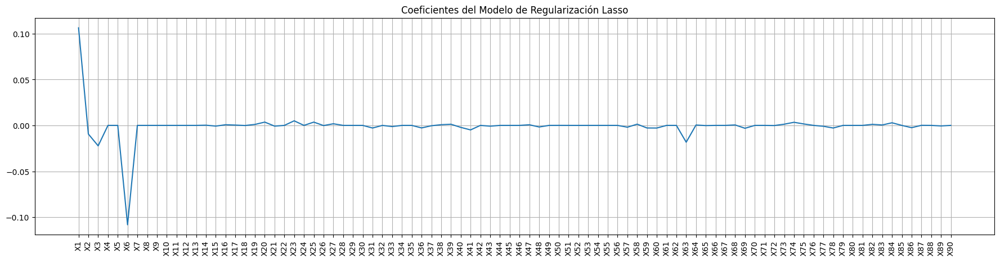

In [ ]:
# Obtención de los coeficientes del modelo Ridge
coeficients2 = model_Lasso2.coef_

plt.figure(figsize = (22, 5))
plt.plot(X_train2.columns, coeficients2)
plt.xticks(rotation = 90)
plt.title("Coeficientes del Modelo de Regularización Lasso")
plt.grid(True)
plt.show()

#### **Validación de supuestos:** 

**1. Autocorrelación en los errores:**

* H0: No hay autocorrelación en los errores
* H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 0.03 de la prueba Durbin-Watson que no está entre 1.5 y 2.5, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que existe autocorrelación entre los errores.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train2 - model_Lasso2.predict(X_train2)

# Calcular la estadística de Durbin-Watson
dw_statistic = durbin_watson(residuals)

# Imprimir el valor de la estadística de Durbin-Watson
print("Estadística de Durbin-Watson:", dw_statistic)

# Comprobar la autocorrelación basada en el valor de la estadística
if dw_statistic < 1.5:
    print("Autocorrelación positiva")
elif dw_statistic > 2.5:
    print("Autocorrelación negativa")
else:
    print("No hay evidencia de autocorrelación")


Estadística de Durbin-Watson: 1.9996239178904571
No hay evidencia de autocorrelación


**2. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.99 de un One-Sample t-test es mayor que (>) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train2 - model_Lasso2.predict(X_train2)

# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(residuals, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

One-sample t-test para la media de los residuos:
T-statistic: 7.437105249992883e-12
P-value: 0.9999999999940661


**3. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0.00 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los errores no son homocedásticos. 

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train2 - model_Lasso2.predict(X_train2)

# Realizar la prueba de Breusch-Pagan
_, p_value, _, _ = het_breuschpagan(residuals, X_train2)
print(p_value)

# Imprimir el resultado de la prueba
if p_value < 0.05:
    print("La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).")
else:
    print("La prueba de Breusch-Pagan no rechaza el supuesto de homocedasticidad (no hay evidencia de heterocedasticidad).")

0.0
La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).


### **EDA después del modelo de regularización LASSO**

In [ ]:
##Obtener coeficientes
lasso_coefs = model_Lasso2.coef_

# Obtener índices de variables con coeficientes no nulos
variables_seleccionadas = np.nonzero(lasso_coefs)[0]

# Obtener nombres de las variables seleccionadas
nombres_variables_seleccionadas = X_train2.columns[variables_seleccionadas]

nombres_variables_seleccionadas

Index(['X1', 'X2', 'X3', 'X6', 'X14', 'X15', 'X16', 'X17', 'X18', 'X19', 'X20',
       'X21', 'X23', 'X25', 'X26', 'X27', 'X30', 'X31', 'X33', 'X36', 'X37',
       'X38', 'X39', 'X40', 'X41', 'X43', 'X47', 'X48', 'X50', 'X52', 'X57',
       'X58', 'X59', 'X60', 'X63', 'X64', 'X65', 'X68', 'X69', 'X72', 'X73',
       'X74', 'X75', 'X77', 'X78', 'X82', 'X83', 'X84', 'X86', 'X87', 'X89'],
      dtype='object')

Gracias al uso de Lasso, hemos identificado un grupo de variables que influyen en nuestra variable objetivo. Sin embargo, aún contamos con un número considerable de variables, lo cual representa un desafío computacional para las herramientas disponibles en nuestro equipo de trabajo. Al analizar la gráfica de los coeficientes generados por Lasso, notamos que hay algunas variables que se alejan significativamente de cero. Por esta razón, hemos decidido establecer un umbral de importancia de 0.01 en valores absolutos en los coeficientes para realizar una segmentación adicional de las variables.

In [ ]:
umbral_importancia = 0.01

# Obtener índices de variables con coeficientes de importancia superior al umbral
variables_seleccionadas = np.where(np.abs(lasso_coefs) > umbral_importancia)[0]

# Obtener nombres de las variables seleccionadas
nombres_variables_seleccionadas = X_train2.columns[variables_seleccionadas]

nombres_variables_seleccionadas

Index(['X1', 'X3', 'X6', 'X63'], dtype='object')

In [ ]:
variables = list(nombres_variables_seleccionadas)
variables.append('Y')

In [ ]:
YearPredictionMSD2 = YearPredictionMSD [variables]

YearPredictionMSD2.head()

,X1,X3,X6,X63,Y
0,49.94357,73.07750,-13.09905,-10.73660,2001
1,48.73215,70.32679,-24.83777,12.59163,2001
2,50.95714,55.81851,-18.54940,1.75729,2001
3,48.24750,36.29772,-26.21683,-11.63176,2001
4,50.97020,67.09964,-16.81409,-4.05003,2001


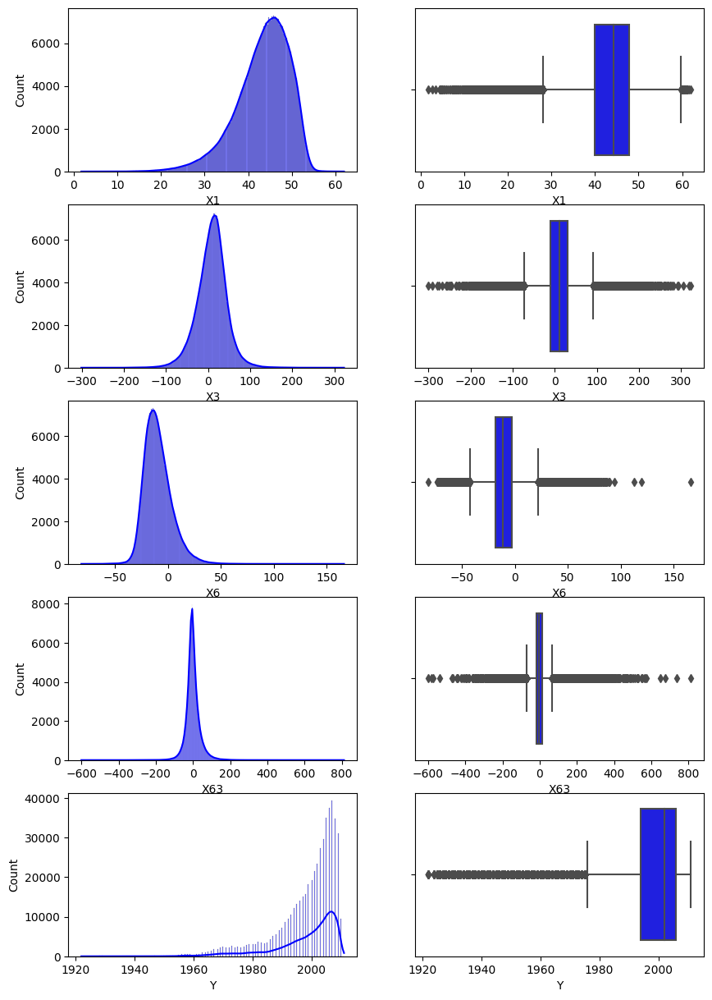

In [ ]:
import warnings

# Ignorando la advertencia específica de Matplotlib: MatplotlibDeprecationWarning
warnings.filterwarnings("ignore", message="Auto-removal of overlapping axes is deprecated")

# Graficando las distribuciones de cada variable:
fig, axs = plt.subplots(figsize=[10,15], ncols=2, nrows = 5)
plotnumber = 2

for col in YearPredictionMSD2.columns:
    if plotnumber <= 10:
       
        ax = plt.subplot(5, 2, plotnumber - 1)        
        sns.histplot(x=YearPredictionMSD2[col],kde=True,color="blue")
        
        ax = plt.subplot(5, 2, plotnumber)  
        sns.boxplot(x=YearPredictionMSD2[col],color="blue")
     
    plotnumber += 2

plt.show()

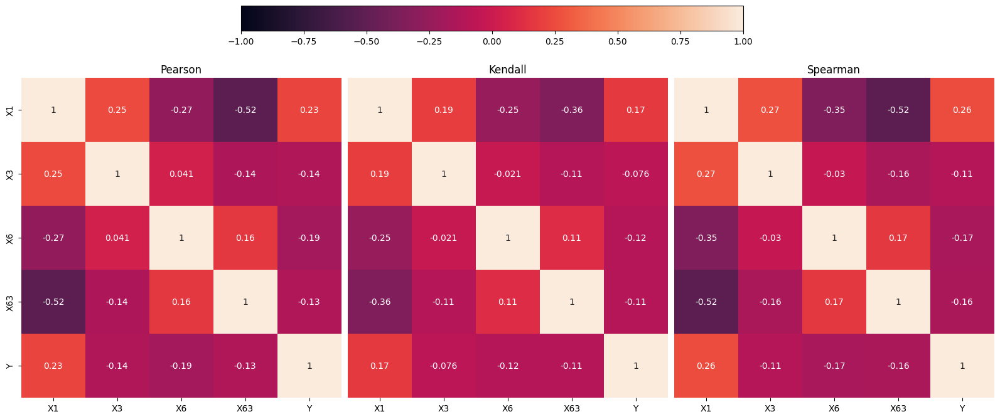

In [ ]:
fig, axs = plt.subplots(figsize=[20, 20], ncols=3)

Pearson_corr_matrix = YearPredictionMSD2.corr(method='pearson') # Calcular la matriz de correlación de Pearson
Kendall_corr_matrix = YearPredictionMSD2.corr(method='kendall') # Calcular la matriz de correlación de Kendall
Spearman_corr_matrix = YearPredictionMSD2.corr(method='spearman') # Calcular la matriz de correlación de Spearman

ax1 = sns.heatmap(Pearson_corr_matrix, annot=True, ax=axs[0], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax1.set_title("Pearson", fontsize=12)

ax2 = sns.heatmap(Kendall_corr_matrix, annot=True, ax=axs[1], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax2.set_title("Kendall", fontsize=12)
ax2.set_yticks([])

ax3 = sns.heatmap(Spearman_corr_matrix, annot=True, ax=axs[2], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax3.set_title("Spearman", fontsize=12)
ax3.set_yticks([])

cbar_ax = fig.add_axes([0.3, 0.66, 0.4, 0.02]) # [left, bottom, width, height]
fig.colorbar(ax1.collections[0], ax=axs, cax=cbar_ax, shrink=0.7, pad=0.05,orientation='horizontal')
fig.subplots_adjust(wspace=0.02)

plt.show()

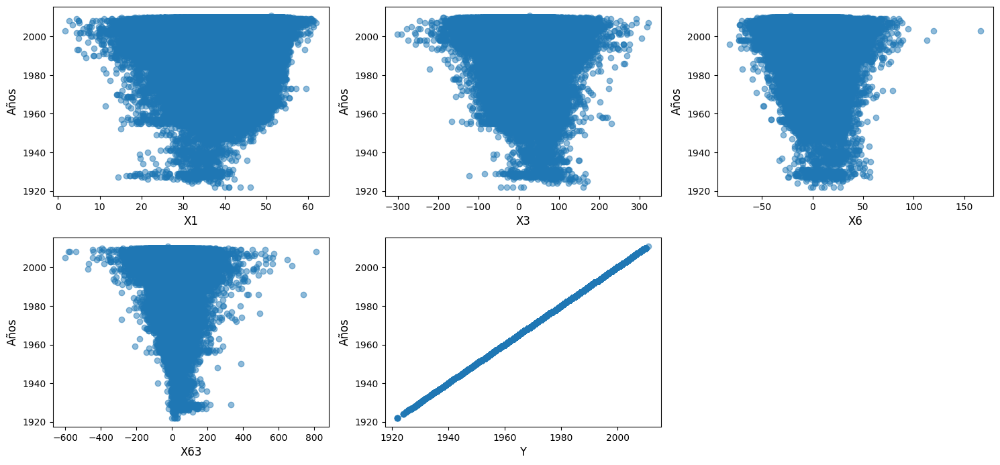

In [ ]:
Y = YearPredictionMSD2['Y']

plt.figure(figsize = (15, 10))
plotnumber = 1

for col in YearPredictionMSD2.columns:
    if plotnumber <= 5:
        ax = plt.subplot(3, 3, plotnumber)
        plt.scatter(YearPredictionMSD2[col], Y, alpha = 0.5)
        plt.xlabel(col, fontsize = 12)
        plt.ylabel("Años", fontsize = 12)
        
    plotnumber += 1
    
plt.tight_layout()
plt.show()

Después de realizar un análisis exploratorio de datos (EDA) en las variables seleccionadas mediante el modelo de regularización Lasso y el umbral de importancia, se observa que las variables explicativas siguen una distribución normal. Sin embargo, no se encontró una correlación significativa entre ellas. Además, se ha confirmado que la variable objetivo es categórica en lugar de numérica.

Estos hallazgos sugieren que el modelo de regresión lineal ordinaria (OLS) puede no ser apropiado para predecir el año de la canción. A pesar de esto, continuaremos con el análisis para conocer los resultados obtenidos y evaluar si existen patrones o relaciones no evidentes en los datos.

Es importante considerar alternativas al modelo OLS, como modelos de clasificación o técnicas específicas para variables categóricas, para lograr una mejor proyección del año de la canción.

## **Parte D**

### **Modelo OLS**

In [ ]:
X_train2 = X_train2 [nombres_variables_seleccionadas]

X_train2.head()

,X1,X3,X6,X63
432804,44.84827,39.62962,-15.78054,-15.21114
14107,40.64447,61.71749,-10.53420,5.76744
445704,42.83931,38.25557,-24.96657,30.25886
360598,48.06036,7.65788,-11.55394,-2.16586
443245,43.18513,-18.89776,-3.88508,18.24084


In [ ]:
X2 = sm.add_constant(X_train2) ## Variables explicativas o predictoras
model = sm.OLS(Y_train2, X2) ## Variable dependiente
results2 = model.fit()
print(results2.summary())

                            OLS Regression Results                            
Dep. Variable:                      Y   R-squared:                       0.103
Model:                            OLS   Adj. R-squared:                  0.103
Method:                 Least Squares   F-statistic:                 1.182e+04
Date:                Wed, 31 May 2023   Prob (F-statistic):               0.00
Time:                        01:49:39   Log-Likelihood:            -1.5488e+06
No. Observations:              412276   AIC:                         3.098e+06
Df Residuals:                  412271   BIC:                         3.098e+06
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1979.6310      0.139   1.42e+04      0.0

### **Validación de supuestos:**

**1. Autocorrelación en los errores:**
*   H0: No hay autocorrelación en los errores
*   H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 2.0 de la prueba Durbin-Watson que está entre 1.5 y 2.5, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que exista autocorrelación entre los errores.


In [ ]:
### Debido a la gran cantidad de datos en el Data Set, debemos seleccionar aleatoriamente 4000 residuos, esto con el fin de poder visualizar correctamente los datos

import random

muestras = random.sample(sorted(results2.resid), k=4000)

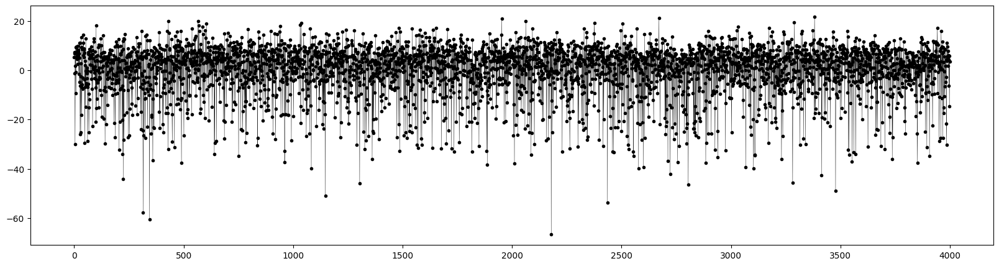

In [ ]:
#Gráfico de errores vs i:

plt.figure(figsize = (20, 5))
plt.plot(muestras, '.-', color = "black", linewidth = 0.3)
plt.show()

**2. Distribución normal de los datos:**
*   H0: Los errores se distribuyen normal
*   H1: Los errores no se distribuyen normal

Dado un valor P de 0.00 de la prueba Jarque-Bera mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que los datos no se distribuyen normal.

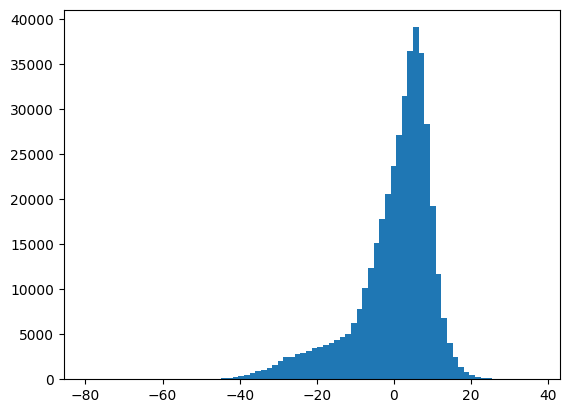

In [ ]:
# Histrograma de los residuales
plt.hist(results2.resid, bins =80)

plt.show()

**3. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.999 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero.

In [ ]:
# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(results2.resid, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic: ", t_stat)
print("P-value: ", p_value)

One-sample t-test para la media de los residuos:
T-statistic:  1.391288363978592e-10
P-value:  0.9999999998889912


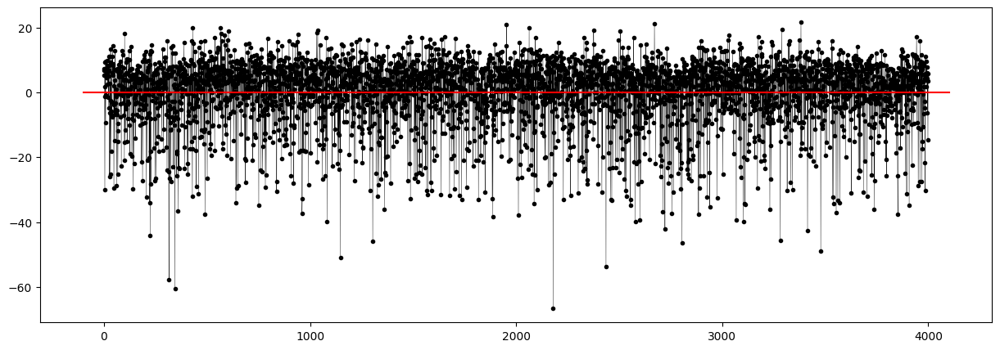

In [ ]:
#Gráfico de errores vs i, con media cero:

plt.figure(figsize = (15, 5))
plt.plot(muestras, '.-', color = "black", linewidth = 0.3)
plt.plot([-100,4100], [0,0], color = "red")
plt.show()

**4. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia para pensar que los errores no son homocedásticos.

In [ ]:
test = sms.het_breuschpagan(results2.resid, results2.model.exog)
name = ["Largrange multiplier statistic", "p-value", "f-value", "f p-value"]
lzip(name, test)

[('Largrange multiplier statistic', 30586.08462581783),
 ('p-value', 0.0),
 ('f-value', 8259.162206583853),
 ('f p-value', 0.0)]

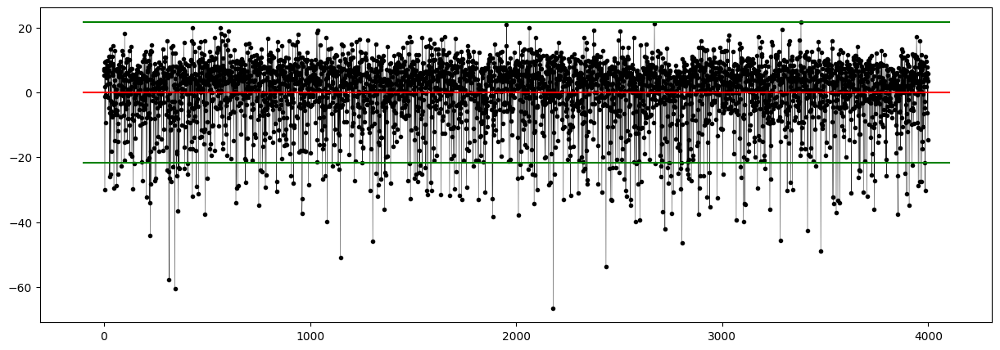

In [ ]:
#Gráfico de errores vs i, con media cero y varianza constante:

mx=max(muestras)

plt.figure(figsize = (15, 5))
plt.plot(muestras, '.-', color = "black", linewidth = 0.3)
plt.plot([-100,4100], [0,0], color = "red")
plt.plot([-100,4100], [mx,mx], color = "green")
plt.plot([-100,4100], [-mx,-mx], color = "green")

plt.show()

## **Conclusión**

En este ejercicio, desde el principio se evidencia que la variable objetivo es categórica, representando el año de lanzamiento de cada canción. A pesar de esto, se ejecuta el modelo de regularización Lasso, logrando reducir la cantidad de variables y mantener únicamente aquellas que mejor explican el modelo.

Luego, se procede a ejecutar el modelo de regresión lineal ordinaria (OLS), obteniendo un coeficiente de determinación (R2) de 0.1. Esto indica que solo el 10% de la variabilidad de los datos puede ser explicada por el modelo. Al revisar los supuestos del modelo OLS, se encuentra que solo se cumplen dos de ellos, la normalidad de los errores y la autocorrelación.

Con base en estos resultados, se concluye que el modelo OLS no es el método óptimo para proyectar el año de lanzamiento de una canción. En su lugar, se sugiere utilizar modelos de clasificación de árboles como Random Forest o Bagging, que son más adecuados para este tipo de variables discretas y pueden brindar mejores resultados en términos de predicción.


# **Punto 3**

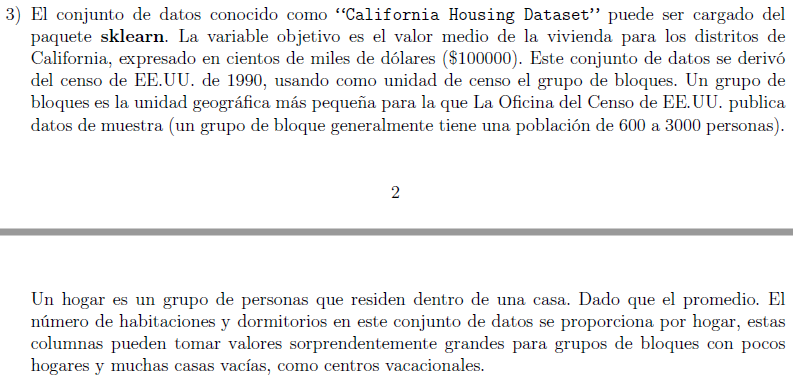

## **Parte A**

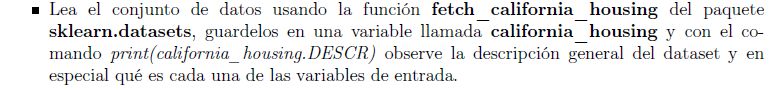

#### **Carga de datos:**

In [ ]:
from sklearn.datasets import fetch_california_housing
import pandas as pd   ## Libreria para manipular y analizar datos

# Cargar el conjunto de datos
california_housing = fetch_california_housing(as_frame=True)

# Imprimir información sobre el conjunto de datos
print(california_housing.DESCR)


.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block group
        - HouseAge      median house age in block group
        - AveRooms      average number of rooms per household
        - AveBedrms     average number of bedrooms per household
        - Population    block group population
        - AveOccup      average number of household members
        - Latitude      block group latitude
        - Longitude     block group longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for California districts,
expressed in hundreds of thousands of dollars ($100,000).

This dataset was derived

**"Y"** corresponde a la Variable "MedHouseVal", lo que indica el valor medio de las viviendas en cientos de miles de dolares ($100.000)

Por lo tanto **"X"** van a ser el resto de variables que se van a usar como predictoras o explicativas

In [ ]:
california_housing.frame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   MedInc       20640 non-null  float64
 1   HouseAge     20640 non-null  float64
 2   AveRooms     20640 non-null  float64
 3   AveBedrms    20640 non-null  float64
 4   Population   20640 non-null  float64
 5   AveOccup     20640 non-null  float64
 6   Latitude     20640 non-null  float64
 7   Longitude    20640 non-null  float64
 8   MedHouseVal  20640 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


In [ ]:
california_housing.frame.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


## **Parte B**

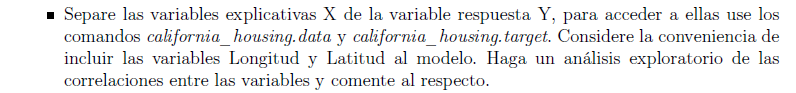

### **Análisis Exploratorio de Datos:**

El conjunto de datos **california_housing** contiene lo siguiente: 

La variable objetivo es el valor medio de las viviendas (**MedHouseVal**) en los distritos de California, expresado en cientos de miles de dólares ($100,000).

Este conjunto de datos se derivó del censo de Estados Unidos de 1990, utilizando una fila por grupo de bloques censales. Un grupo de bloques censales es la unidad geográfica más pequeña para la cual la Oficina del Censo de Estados Unidos publica datos de muestra (un grupo de bloques censales generalmente tiene una población de 600 a 3,000 personas).

Un hogar es un grupo de personas que residen en una vivienda. Dado que el número promedio de habitaciones y dormitorios en este conjunto de datos se proporciona por hogar, estas columnas pueden tener valores sorprendentemente altos para grupos de bloques con pocos hogares y muchas casas vacías, como centros vacacionales.

### **Forma del dataset**

In [ ]:
# Convierte los datos a un DataFrame de pandas
df_california_housing = pd.DataFrame(california_housing['data'], columns=california_housing['feature_names'])

# Agrega la columna target al DataFrame
df_california_housing['MedHouseVal'] = california_housing['target']

# Reorganiza las columnas del DataFrame
df_california_housing = df_california_housing[['MedHouseVal'] + df_california_housing.columns[:-1].tolist()]

# Ahora trabajaremos con el DataFrame df_california_housing
df_california_housing

,MedHouseVal,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
0,4.526,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23
1,3.585,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22
2,3.521,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24
3,3.413,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25
4,3.422,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25
...,...,...,...,...,...,...,...,...,...
20635,0.781,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09
20636,0.771,2.5568,18.0,6.114035,1.315789,356.0,3.122807,39.49,-121.21
20637,0.923,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22
20638,0.847,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32


In [ ]:
# Revisión de la forma de la matriz en términos de filas y columnas.
df_california_housing.shape

(20640, 9)

In [ ]:
# Revisión de los primeros datos de la matriz.
df_california_housing.head(5)

,MedHouseVal,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
0,4.526,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23
1,3.585,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22
2,3.521,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24
3,3.413,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25
4,3.422,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25


In [ ]:
# Revisión de los últomos datos de la matriz.
df_california_housing.tail(5)

,MedHouseVal,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
20635,0.781,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09
20636,0.771,2.5568,18.0,6.114035,1.315789,356.0,3.122807,39.49,-121.21
20637,0.923,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22
20638,0.847,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32
20639,0.894,2.3886,16.0,5.254717,1.162264,1387.0,2.616981,39.37,-121.24


In [ ]:
#Verificando el tipo de datos de cada una de las variables de la matriz:
df_california_housing.dtypes

MedHouseVal    float64
MedInc         float64
HouseAge       float64
AveRooms       float64
AveBedrms      float64
Population     float64
AveOccup       float64
Latitude       float64
Longitude      float64
dtype: object

In [ ]:
# Revisión de las métricas estadísticas descriptivas de las variables numéricas
def fun_tabla_descriptivas(columnas):
    tabla_descriptivas=pd.DataFrame(columnas.describe())
    tabla_descriptivas.loc['coef. variation']=columnas.std()/columnas.mean()
    tabla_descriptivas.loc['skew']=skew(columnas)
    tabla_descriptivas.loc['kurtosis']=kurtosis(columnas)
    return tabla_descriptivas

In [ ]:
fun_tabla_descriptivas(df_california_housing)

,MedHouseVal,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,2.068558,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704
std,1.153956,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532
min,0.149990,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000
25%,1.196000,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000
50%,1.797000,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000
75%,2.647250,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000
max,5.000010,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000
coef. variation,0.557855,0.490825,0.439448,0.455733,0.432134,0.794444,3.382356,0.059945,-0.016756
skew,0.977692,1.646537,0.060326,20.696365,31.314680,4.935500,97.632465,0.465919,-0.297780


In [ ]:
# Revisión del porcentaje de datos nulos en cada una de las variables
df_california_housing.isnull().sum()/len(df_california_housing)*100

MedHouseVal    0.0
MedInc         0.0
HouseAge       0.0
AveRooms       0.0
AveBedrms      0.0
Population     0.0
AveOccup       0.0
Latitude       0.0
Longitude      0.0
dtype: float64

En general, se observa que es un buen dataset, contiene variables numéricas tipo float y no se observan datos nulos.

### **Visualización de los Datos:**

#### *Análisis Univariado:*

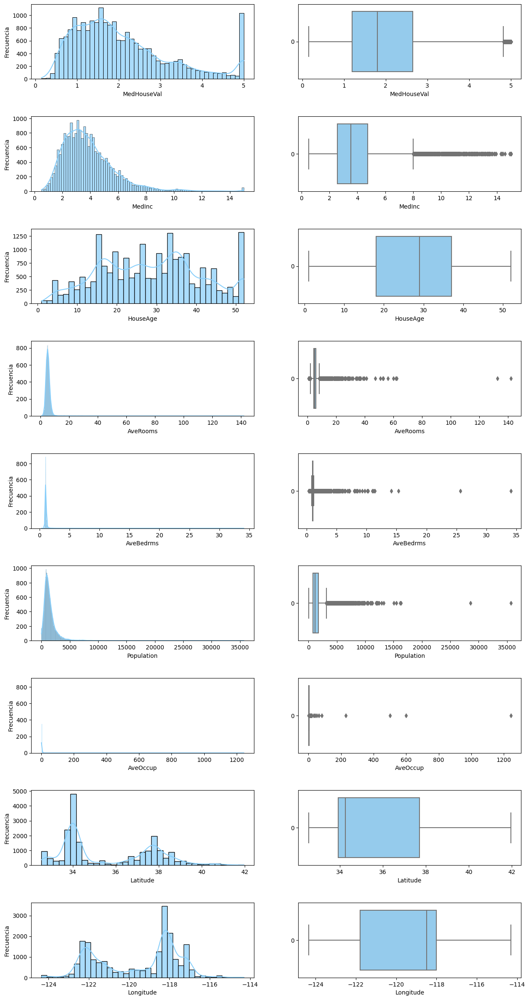

In [ ]:
import scipy.stats as stats
variables = ['MedHouseVal',	'MedInc',	'HouseAge',	'AveRooms',	'AveBedrms',	'Population',	'AveOccup',	'Latitude',	'Longitude']

# Configuración de la matriz de gráficos
fig, axes = plt.subplots(nrows=len(variables), ncols=2, figsize=(15, 30))
fig.subplots_adjust(hspace=0.5)

# Generar histogramas y boxplots para cada variable
for i, variable in enumerate(variables):
    ax_hist = axes[i, 0]
    ax_box = axes[i, 1]
    #ax_stat = axes[i, 2]

    # Histograma
    sns.histplot(df_california_housing[variable], ax=ax_hist, kde=True, bins='auto', color="lightskyblue", alpha=0.7)
    ax_hist.set_xlabel(variable)
    ax_hist.set_ylabel('Frecuencia')

    # Boxplot
    sns.boxplot(df_california_housing[variable], ax=ax_box, color="lightskyblue", orient='h')
    ax_box.set_xlabel(variable)

    #stats.probplot(df_california_housing[variable], dist="norm", plot=ax_stat)

plt.show()

#### *Análisis Multivariado*

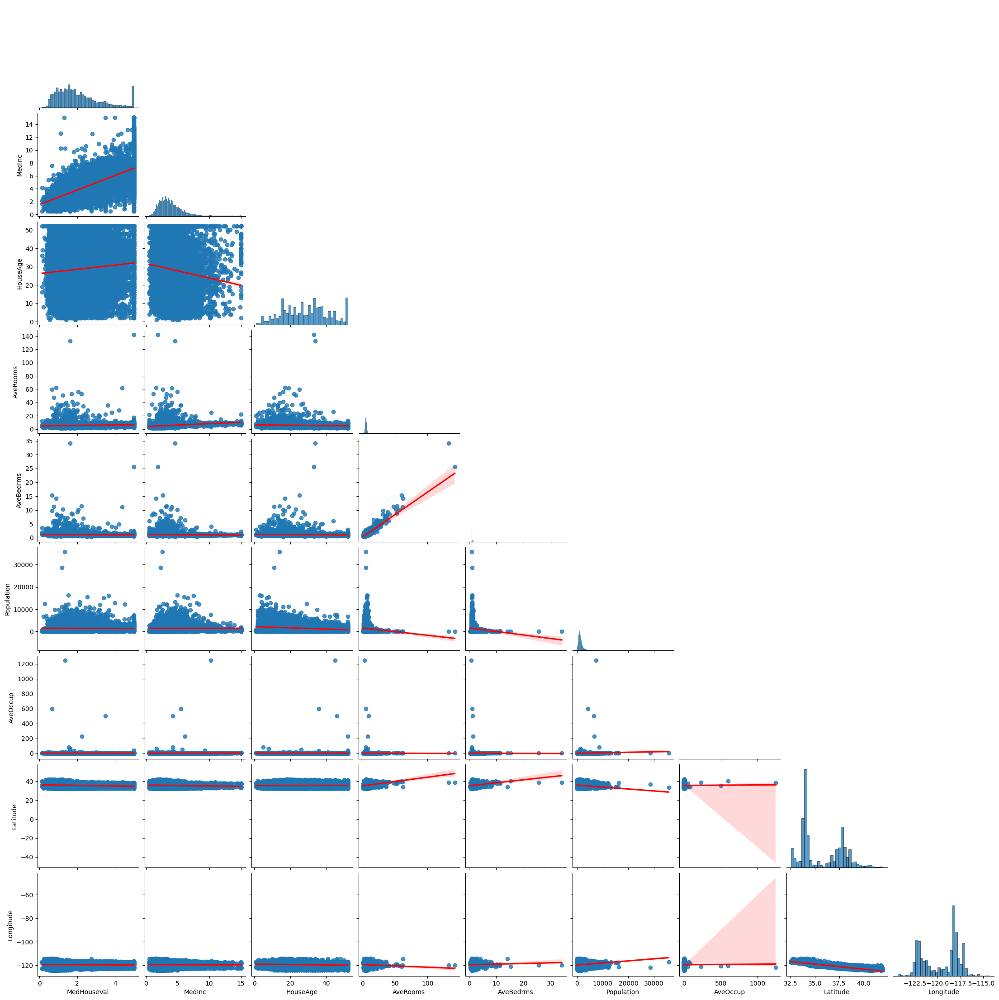

In [ ]:
for_check = df_california_housing[['MedHouseVal',	'MedInc',	'HouseAge',	'AveRooms',	'AveBedrms',	'Population',	'AveOccup',	'Latitude',	'Longitude']]
sns.pairplot(for_check, kind="reg", plot_kws={'line_kws':{'color':'red'}} , corner=True)
plt.show()

#### *Correlación entre variables*

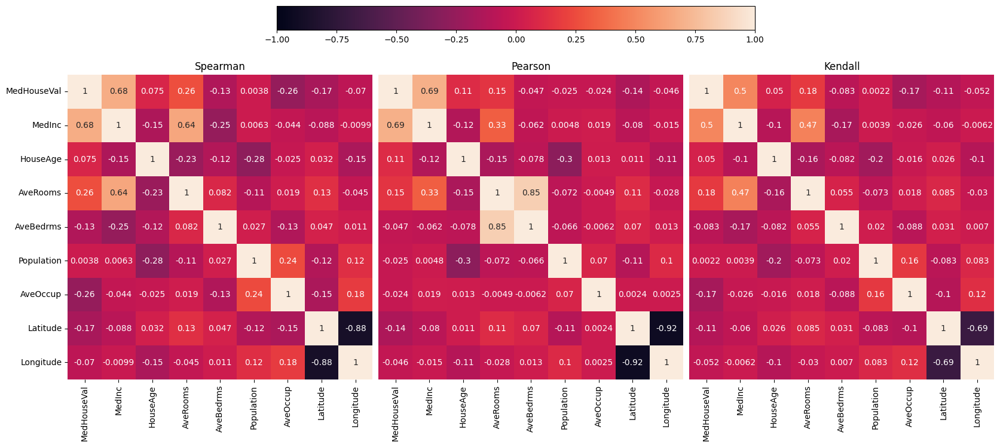

In [ ]:
fig, axs = plt.subplots(figsize=[20, 20], ncols=3)

Pearson_corr_matrix = df_california_housing.corr(method='pearson') # Calcular la matriz de correlación de Pearson
Kendall_corr_matrix = df_california_housing.corr(method='kendall') # Calcular la matriz de correlación de Kendall
Spearman_corr_matrix = df_california_housing.corr(method='spearman') # Calcular la matriz de correlación de Spearman

ax1 = sns.heatmap(Spearman_corr_matrix, annot=True, ax=axs[0], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax1.set_title("Spearman", fontsize=12)

ax2 = sns.heatmap(Pearson_corr_matrix, annot=True, ax=axs[1], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax2.set_title("Pearson", fontsize=12)
ax2.set_yticks([])

ax3 = sns.heatmap(Kendall_corr_matrix, annot=True, ax=axs[2], vmin=-1, vmax=1, cbar=False, square=True, annot_kws={"fontsize": 10})
ax3.set_title("Kendall", fontsize=12)
ax3.set_yticks([])

cbar_ax = fig.add_axes([0.3, 0.66, 0.4, 0.02]) # [left, bottom, width, height]
fig.colorbar(ax1.collections[0], ax=axs, cax=cbar_ax, shrink=0.7, pad=0.05,orientation='horizontal')
fig.subplots_adjust(wspace=0.02)

plt.show()

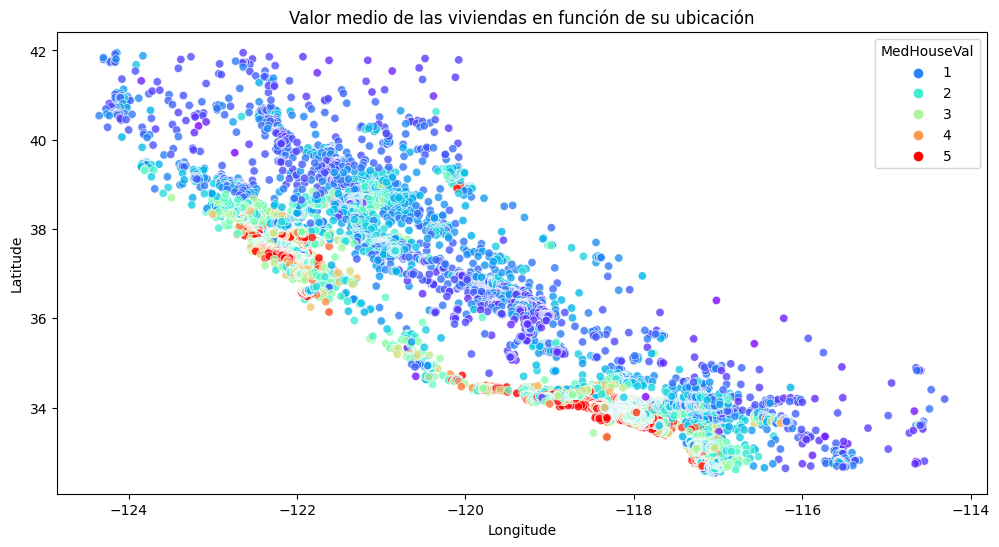

In [ ]:
plt.figure(figsize=(12,6))
sns.scatterplot(x='Longitude',y='Latitude', data=df_california_housing, hue= 'MedHouseVal',palette='rainbow', alpha=0.8)
plt.title('Valor medio de las viviendas en función de su ubicación')
plt.show()


En nuestro análisis, se pueden distinguir diversas regiones con una mayor concentración de datos y grupos en relación con la variable "MedHouseVal". Sin embargo, para obtener una apreciación más precisa, utilizaremos el mapa de California como telón de fondo para comprender estas regiones.

In [ ]:
import requests
import folium
from folium import plugins

# Crear un mapa centrado en California
ca_map = folium.Map(location=[37.25, -119.25], zoom_start=5.5, width=900, height=550)

# Obtener los datos de latitud, longitud y MedHouseVal del DataFrame df_california_housing
latitudes = df_california_housing['Latitude']
longitudes = df_california_housing['Longitude']
med_house_vals = df_california_housing['MedHouseVal']

# Agregar marcadores para cada punto con el valor medio de las viviendas correspondiente
for lat, lon, val in zip(latitudes, longitudes, med_house_vals):
    # Asignar el color correspondiente según el valor de MedHouseVal
    if val < 1:
        color = 'blue'
    elif val < 2:
        color = 'green'
    elif val < 3:
        color = 'yellow'
    elif val < 4:
        color = 'orange'
    elif val < 5:
        color = 'red'
    else:
        color = 'purple'

    # Crear un marcador con el valor medio de las viviendas como etiqueta
    label = f'MedHouseVal: {val}'
    folium.CircleMarker(location=[lat, lon], radius=2, color=color, fill=True, fill_color=color, tooltip=label).add_to(ca_map)

# Agregar un triángulo sobre San Francisco
folium.RegularPolygonMarker(location=[37.7749, -122.4194], fill_color='black', number_of_sides=3, radius=10).add_to(ca_map)

# Agregar un triángulo sobre San Diego
folium.RegularPolygonMarker(location=[32.7157, -117.1611], fill_color='black', number_of_sides=3, radius=10).add_to(ca_map)

# Agregar un triángulo sobre Los Ángeles
folium.RegularPolygonMarker(location=[34.0522, -118.2437], fill_color='black', number_of_sides=3, radius=10).add_to(ca_map)

# Crear el cuadro de convenciones
legend_html = '''
     <div style="position: fixed;
                 top: 50px; right: 50px; width: 160px; height: 180px;
                 border:2px solid grey; z-index:9999; font-size:14px;
                 background-color:white;
                 ">&nbsp;<b>MedHouseVal</b><br>
                  &nbsp;0 - 1 &nbsp;&nbsp;<i class="fa fa-circle"
                                style="color:blue"></i><br>
                  &nbsp;1 - 2 &nbsp;&nbsp;<i class="fa fa-circle"
                                style="color:green"></i><br>
                  &nbsp;2 - 3 &nbsp;&nbsp;<i class="fa fa-circle"
                                style="color:yellow"></i><br>
                  &nbsp;3 - 4 &nbsp;&nbsp;<i class="fa fa-circle"
                                style="color:orange"></i><br>
                  &nbsp;4 - 5 &nbsp;&nbsp;<i class="fa fa-circle"
                                style="color:red"></i><br>
                  &nbsp;5+ &nbsp;&nbsp;&nbsp;&nbsp;<i class="fa fa-circle"
                                style="color:purple"></i>
     </div>
     '''

ca_map.get_root().html.add_child(folium.Element(legend_html))

# Mostrar el mapa
ca_map



Es evidente que los datos se encuentran concentrados en áreas costeras. Mediante el análisis del mapa, hemos identificado algunas regiones de como San Francisco, Los Ángeles y San Diego (Ciudades costeras) donde se presenta una mayor concentración de datos.

Una vez identificadas estas regiones, procederemos a examinar si existen variaciones en los precios de las viviendas según la ubicación geográfica. Para realizar esto, aplicaremos una codificación de colores basada en la variable "MedHouseVal". De esta manera, podremos evidenciar que la ubicación geográfica de una vivienda influye en su precio, observándose una mayor concentración de viviendas con valores más elevados en las áreas costeras y en regiones como San Francisco, Los Ángeles y San Diego.

### **Sobre la latitud y longitud para regresión**

La latitud y longitud son dos medidas geográficas que suelen estar altamente correlacionadas en áreas geográficas limitadas, como un distrito. Esta correlación elevada se deriva del hecho de que ambas variables capturan información similar sobre la ubicación geográfica de los puntos dentro del distrito. Al presentar información redundante, estas variables pueden introducir sesgos y disminuir la capacidad del modelo de regresión para identificar relaciones significativas entre las variables explicativas y la variable objetivo.

Por lo tanto, es conveniente eliminar tanto la latitud como la longitud para reducir la multicolinealidad en el modelo. Esta acción mejora la interpretación de los coeficientes remanentes y evita la inflación de varianza en las estimaciones de los coeficientes de regresión. Al eliminar estas variables, se logra una simplificación del modelo y se minimiza el riesgo de sobreajuste.

No obstante, cabe destacar que la decisión de eliminar variables debe ser respaldada por un análisis exhaustivo y consideraciones específicas del contexto del problema. En algunos casos, la latitud y la longitud podrían contener información relevante que justifique su inclusión en el modelo. Por tanto, resulta fundamental contar con conocimientos expertos y comprensión del dominio para tomar decisiones adecuadas en cada situación particular.

Es importante tener en cuenta que, aunque en ocasiones no se encuentra un patrón evidente en la visualización, esto no significa necesariamente que no exista una relación entre la ubicación espacial y el valor medio de las viviendas, aunque este no es el caso. Para obtener una comprensión más completa, es recomendable realizar análisis adicionales, como pruebas estadísticas o técnicas de clusterización espacial, que puedan revelar patrones o relaciones más sutiles en los datos.

En un ejercicio de clusterización, la inclusión de las variables de latitud y longitud puede ser relevante y justificada. A diferencia del caso de regresión, en la clusterización se busca agrupar observaciones similares en función de sus características, sin la necesidad de establecer una relación predictiva con una variable objetivo específica.

En el análisis de precios de viviendas basado en clusterización geoespacial, la inclusión de las variables de latitud y longitud es esencial. Estas variables permiten capturar patrones espaciales y estructuras territoriales relevantes para la formación de clusters. Por ejemplo, al realizar una clusterización basada en latitud y longitud en datos de precios de viviendas, es posible identificar agrupaciones de viviendas con características similares en áreas geográficas específicas. Estos grupos geográficos pueden representar segmentos de mercado con propiedades de precios similares y características socioeconómicas comunes. Esta información puede ser de gran valor para la toma de decisiones en temas como la planificación urbana, la inversión inmobiliaria y la segmentación de mercado en el sector de bienes raíces. En resumen, la inclusión de las variables de latitud y longitud en la clusterización geoespacial de precios de viviendas proporciona una comprensión más completa de los datos, revelando patrones geográficos relevantes que tienen implicaciones prácticas en el sector inmobiliario.

Por último, es importante destacar que en este estudio la latitud y longitud no parecen estar significativamente relacionadas con la variable dependiente. Por lo tanto, se tomará la decisión de eliminar estas variables de los modelos en etapas posteriores del análisis. Esta acción se fundamenta en la falta de evidencia de una relación sustancial entre las coordenadas geográficas y la variable objetivo en el contexto específico de este ejercicio.


#### **Asignar Variable Dependiente e Independiente**

In [ ]:
# Acceder a los datos y las etiquetas
Y_california_housing = california_housing.target  # Etiquetas (valor objetivo)
X_california_housing = california_housing.data  # Características (atributos)

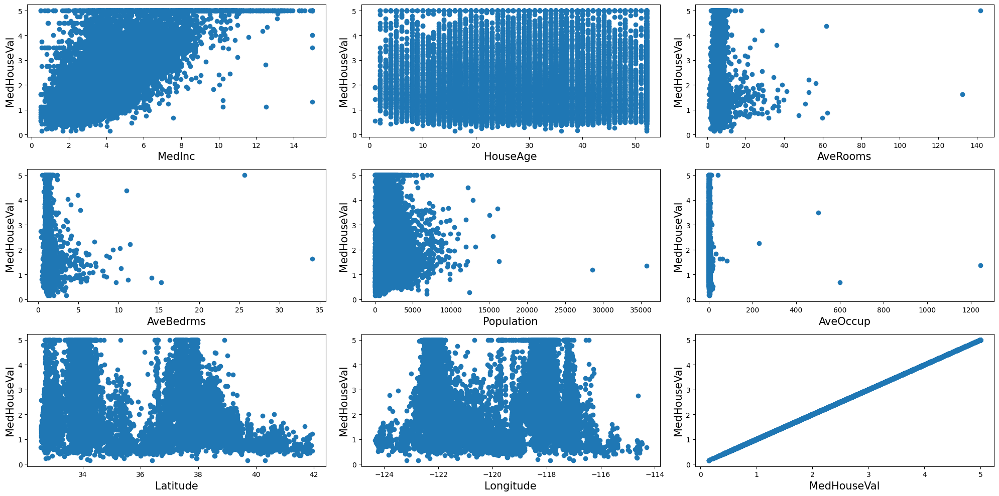

In [ ]:
plt.figure(figsize = (20, 10))
plotnumber = 1

for col in california_housing.frame.columns:
    if plotnumber <= 14:
        ax = plt.subplot(3, 3, plotnumber)
        plt.scatter(california_housing.frame[col], Y_california_housing)
        plt.xlabel(col, fontsize = 15)
        plt.ylabel(Y_california_housing.name, fontsize = 15)
        
    plotnumber += 1
    
plt.tight_layout()
plt.show()

Después de realizar el análisis multivariado, podemos concluir que no se observa una correlación significativa en los datos respecto a la variable objetivo. No se aprecian formas elípticas, inversas ni directamente proporcionales. Sin embargo, es importante destacar que aún quedan datos atípicos por eliminar en futuros pasos del ejercicio. Se espera qué al realizar esta limpieza de datos atípicos, se logre mejorar la correlación entre algunas de las variables y la variable objetivo.

## **Parte C**

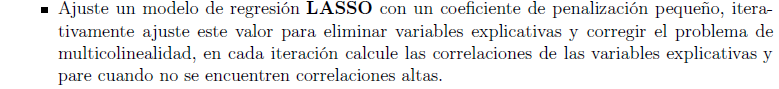

### **Hold Out (80-20):**

Se considera una buena práctica realizar una división de los datos antes de aplicar un modelo, en general, por las siguientes razones:

1. Evaluación imparcial del rendimiento: Al dividir los datos en conjuntos de entrenamiento y prueba, podemos obtener una evaluación imparcial del rendimiento del modelo. Utilizamos el conjunto de entrenamiento para ajustar el modelo y el conjunto de prueba para evaluar su rendimiento. De esta manera, obtenemos una estimación más realista de cómo el modelo generalizará en datos no vistos previamente. Esto ayuda a evitar el sobreajuste, donde el modelo se ajusta demasiado a los datos de entrenamiento y no generaliza bien en nuevos datos.

2. Selección del modelo adecuado: El modelo utiliza la regularización para penalizar los coeficientes de las variables menos importantes, lo que puede resultar en la eliminación de características irrelevantes o redundantes. Al dividir los datos, podemos ajustar diferentes modelos utilizando diferentes conjuntos de hiperparámetros y seleccionar aquel que mejor se desempeñe en el conjunto de prueba. Esto nos ayuda a evitar la elección de un modelo sobreajustado que se ajuste demasiado a los datos de entrenamiento y no generalice adecuadamente.

3. Estimación del rendimiento futuro: Al utilizar el conjunto de prueba, podemos obtener una estimación del rendimiento futuro del modelo en datos reales no vistos. Esto resulta especialmente útil si estamos desarrollando un modelo para su implementación en un entorno de producción, ya que nos brinda una idea de cómo se comportará el modelo en el mundo real.

Con base a lo expuesto, a partir de este punto trabajaremos únicamente con una parte del conjunto de datos.

In [ ]:
##Eliminamos longitud y latitud del data set
X_california_housing = X_california_housing[['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup']]

In [ ]:
#Hold Out
X_train_CH, X_test_CH, Y_train_CH, Y_test_CH = train_test_split(X_california_housing, Y_california_housing, test_size=0.2, random_state=42)
print(X_train_CH.shape)
print(X_test_CH.shape)

(16512, 6)
(4128, 6)


#### **Modelo OLS Inicial**

In [ ]:
X = sm.add_constant(X_train_CH) ## Variables explicativas o predictoras
model_CH = sm.OLS(Y_train_CH, X) ## Variable dependiente
results_CH = model_CH.fit()
print(results_CH.summary())

                            OLS Regression Results                            
Dep. Variable:            MedHouseVal   R-squared:                       0.546
Model:                            OLS   Adj. R-squared:                  0.546
Method:                 Least Squares   F-statistic:                     3307.
Date:                Wed, 31 May 2023   Prob (F-statistic):               0.00
Time:                        01:52:52   Log-Likelihood:                -19308.
No. Observations:               16512   AIC:                         3.863e+04
Df Residuals:                   16505   BIC:                         3.868e+04
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.5529      0.032    -17.134      0.0

#### **Validación de supuestos**

**1. Autocorrelación en los errores:**
*   H0: No hay autocorrelación en los errores
*   H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 1.967 de la prueba Durbin-Watson que está entre 1.5 y 2.5, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que exista autocorrelación entre los errores.


In [ ]:
import random

muestras_CH = random.sample(sorted(results_CH.resid), k=6000)

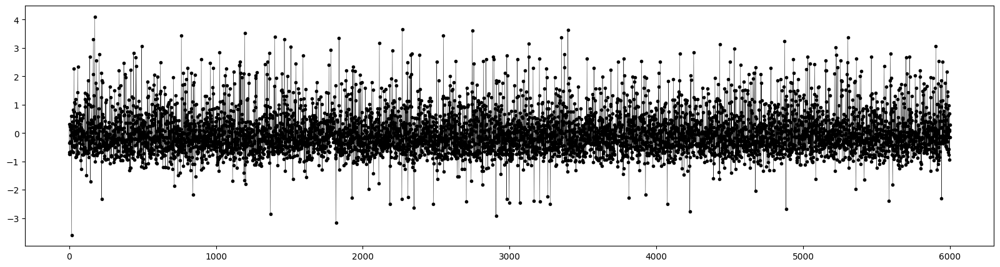

In [ ]:
#Gráfico de errores vs i:

plt.figure(figsize = (20, 5))
plt.plot(muestras_CH, '.-', color = "black", linewidth = 0.3)
plt.show()

**2. Distribución normal de los datos:**
*   H0: Los errores se distribuyen normal
*   H1: Los errores no se distribuyen normal

Dado un valor P de 0.00 de la prueba Jarque-Bera mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que los datos no se distribuyen normal.

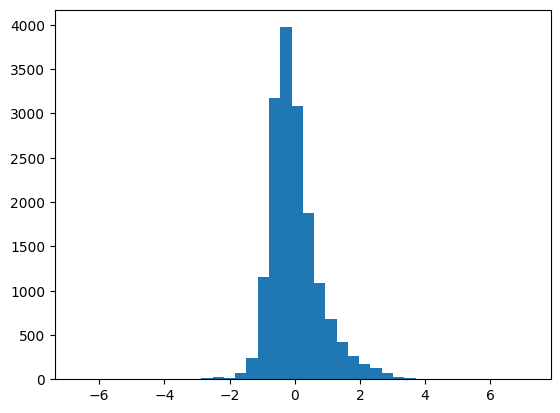

In [ ]:
# Histrograma de los residuales
plt.hist(results_CH.resid, bins =40)

plt.show()

**3. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.999 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero.

In [ ]:
# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(results_CH.resid, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic: ", t_stat)
print("P-value: ", p_value)

One-sample t-test para la media de los residuos:
T-statistic:  5.080449587196337e-11
P-value:  0.9999999999594644


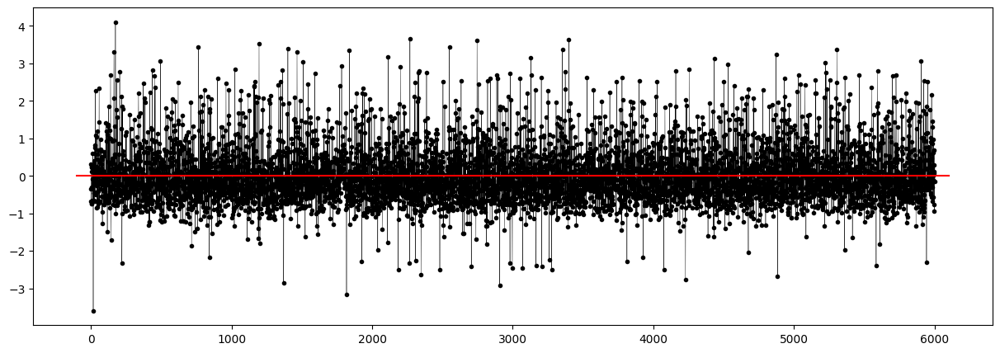

In [ ]:
#Gráfico de errores vs i, con media cero:

plt.figure(figsize = (15, 5))
plt.plot(muestras_CH, '.-', color = "black", linewidth = 0.3)
plt.plot([-100,6100], [0,0], color = "red")
plt.show()

**4. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia para pensar que los errores no son homocedásticos.

In [ ]:
test = sms.het_breuschpagan(results_CH.resid, results_CH.model.exog)
name = ["Largrange multiplier statistic", "p-value", "f-value", "f p-value"]
lzip(name, test)

[('Largrange multiplier statistic', 1771.665948449809),
 ('p-value', 0.0),
 ('f-value', 330.62736091892134),
 ('f p-value', 0.0)]

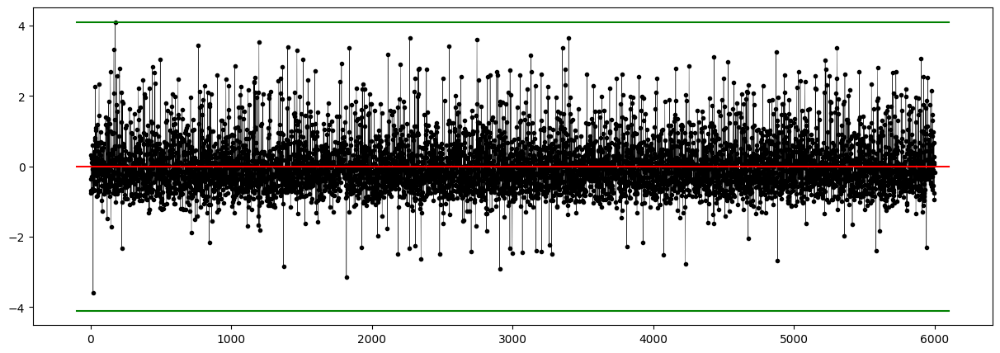

In [ ]:
#Gráfico de errores vs i, con media cero y varianza constante:

mx=max(muestras_CH)

plt.figure(figsize = (15, 5))
plt.plot(muestras_CH, '.-', color = "black", linewidth = 0.3)
plt.plot([-100,6100], [0,0], color = "red")
plt.plot([-100,6100], [mx,mx], color = "green")
plt.plot([-100,6100], [-mx,-mx], color = "green")

plt.show()

En este modelo de regresión de mínimos cuadrados ordinarios (OLS), previo a ejecutar el proceso de Lasso, hemos verificado que se cumplen los supuestos y hemos obtenido un coeficiente de determinación (R2) de 0.62. Esto indica que las variables explicativas son capaces de explicar el 62% de la variabilidad del modelo. No obstante, hemos identificado un problema de multicolinealidad, el cual está asociado a las variables de longitud y latitud, ya que presentan una alta correlación entre sí.

#### **Modelo de Regularización Lasso**

#### Identificación del Alpha óptimo

In [ ]:
umbral = 0.01
alphas = np.arange(0.00001, 0.68,0.01) # A partir de un alpha de 0.68 ya solo queda un atributo
correlation_matrices = []

for alpha in alphas:
    model_Lasso = Lasso(alpha=alpha)
    model_Lasso.fit(X_train_CH, Y_train_CH)
    coefficients = pd.Series(model_Lasso.coef_, index=X_train_CH.columns)
    selected_features = coefficients[abs(coefficients) > umbral]
    correlation_matrix = X_train_CH[selected_features.index].corr()
    correlation_matrices.append(correlation_matrix)

for alpha, correlation_matrix in zip(alphas, correlation_matrices):
    print("Alpha:", alpha)
    print("Matriz de correlación:")
    print(correlation_matrix)
    print("--------")

Alpha: 1e-05
Matriz de correlación:
             MedInc  HouseAge  AveRooms  AveBedrms
MedInc     1.000000 -0.121711  0.336013  -0.072550
HouseAge  -0.121711  1.000000 -0.160892  -0.087983
AveRooms   0.336013 -0.160892  1.000000   0.836163
AveBedrms -0.072550 -0.087983  0.836163   1.000000
--------
Alpha: 0.01001
Matriz de correlación:
             MedInc  HouseAge  AveRooms  AveBedrms
MedInc     1.000000 -0.121711  0.336013  -0.072550
HouseAge  -0.121711  1.000000 -0.160892  -0.087983
AveRooms   0.336013 -0.160892  1.000000   0.836163
AveBedrms -0.072550 -0.087983  0.836163   1.000000
--------
Alpha: 0.02001
Matriz de correlación:
             MedInc  HouseAge  AveRooms  AveBedrms
MedInc     1.000000 -0.121711  0.336013  -0.072550
HouseAge  -0.121711  1.000000 -0.160892  -0.087983
AveRooms   0.336013 -0.160892  1.000000   0.836163
AveBedrms -0.072550 -0.087983  0.836163   1.000000
--------
Alpha: 0.03001
Matriz de correlación:
            MedInc  HouseAge  AveRooms
MedInc    1.000000 

In [ ]:
## Lasso Regression Model
model_Lasso = Lasso(alpha = 0.03001)

model_Lasso.fit(X_train_CH, Y_train_CH)

## Score ridge regression
model_Lasso.score(X_train_CH, Y_train_CH)


0.5175974071612963

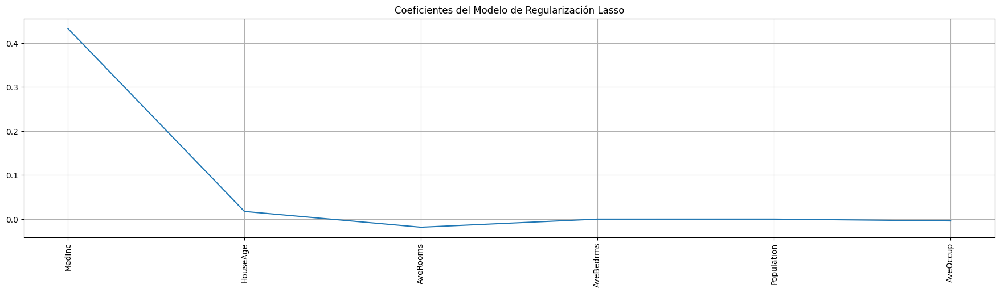

In [ ]:
# Obtención de los coeficientes del modelo Ridge
coeficients_CH = model_Lasso.coef_

plt.figure(figsize = (22, 5))
plt.plot(X_train_CH.columns, coeficients_CH)
plt.xticks(rotation = 90)
plt.title("Coeficientes del Modelo de Regularización Lasso")
plt.grid(True)
plt.show()

#### **Validación de supuestos:** 

**1. Autocorrelación en los errores:**

* H0: No hay autocorrelación en los errores
* H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 1.97 de la prueba Durbin-Watson que está entre 1.5 y 2.5, no es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que no existe autocorrelación entre los errores.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train_CH - model_Lasso.predict(X_train_CH)

# Calcular la estadística de Durbin-Watson
dw_statistic = durbin_watson(residuals)

# Imprimir el valor de la estadística de Durbin-Watson
print("Estadística de Durbin-Watson:", dw_statistic)

# Comprobar la autocorrelación basada en el valor de la estadística
if dw_statistic < 1.5:
    print("Autocorrelación positiva")
elif dw_statistic > 2.5:
    print("Autocorrelación negativa")
else:
    print("No hay evidencia de autocorrelación")


Estadística de Durbin-Watson: 1.9706769140074616
No hay evidencia de autocorrelación


**2. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.99 de un One-Sample t-test es mayor que (>) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero.

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train_CH - model_Lasso.predict(X_train_CH)

# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(residuals, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic:", t_stat)
print("P-value:", p_value)

One-sample t-test para la media de los residuos:
T-statistic: -2.5003388352813764e-14
P-value: 0.99999999999998


**3. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0.00 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia suficiente para afirmar que los errores no son homocedásticos. 

In [ ]:
# Obtener los residuos del modelo Ridge
residuals = Y_train_CH - model_Lasso.predict(X_train_CH)

# Realizar la prueba de Breusch-Pagan
_, p_value, _, _ = het_breuschpagan(residuals, X_train_CH)
print(p_value)

# Imprimir el resultado de la prueba
if p_value < 0.05:
    print("La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).")
else:
    print("La prueba de Breusch-Pagan no rechaza el supuesto de homocedasticidad (no hay evidencia de heterocedasticidad).")

0.0
La prueba de Breusch-Pagan rechaza el supuesto de homocedasticidad (hay heterocedasticidad).


## **Parte D**

image.png

In [ ]:
# Variables que se mantienen para su uso posterior y eliminamos Latitud y longitud

variables_a_conservar = ['MedHouseVal',	'MedInc', 'HouseAge',	'AveRooms']

#Eliminamos las variables de los datos de entrenamiento para usarlos en el modelo OLS

df_california_housing_new = df_california_housing [variables_a_conservar]

df_california_housing_new.head()

,MedHouseVal,MedInc,HouseAge,AveRooms
0,4.526,8.3252,41.0,6.984127
1,3.585,8.3014,21.0,6.238137
2,3.521,7.2574,52.0,8.288136
3,3.413,5.6431,52.0,5.817352
4,3.422,3.8462,52.0,6.281853


#### **Modelo OLS**

In [ ]:
# Tambien para las variables del modelo dejamos solo lo que necesitamos
variables_a_conservar = ['MedInc','HouseAge',	'AveRooms']
X_train_CH_New = X_train_CH[variables_a_conservar]

In [ ]:
X = sm.add_constant(X_train_CH_New) ## Variables explicativas o predictoras nuevas
model_CH_New = sm.OLS(Y_train_CH, X) ## Variable dependiente y podemos dejar la del paso anterior
results_CH_New = model_CH_New.fit()
print(results_CH_New.summary())

                            OLS Regression Results                            
Dep. Variable:            MedHouseVal   R-squared:                       0.516
Model:                            OLS   Adj. R-squared:                  0.516
Method:                 Least Squares   F-statistic:                     5860.
Date:                Wed, 31 May 2023   Prob (F-statistic):               0.00
Time:                        01:52:56   Log-Likelihood:                -19839.
No. Observations:               16512   AIC:                         3.969e+04
Df Residuals:                   16508   BIC:                         3.972e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0173      0.025      0.697      0.4

#### **Validación de supuestos**

**1. Autocorrelación en los errores:**
*   H0: No hay autocorrelación en los errores
*   H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 1.97 de la prueba Durbin-Watson que está entre 1.5 y 2.5, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que exista autocorrelación entre los errores.


In [ ]:
import random

muestras_CH_New = random.sample(sorted(results_CH_New.resid), k=6000)

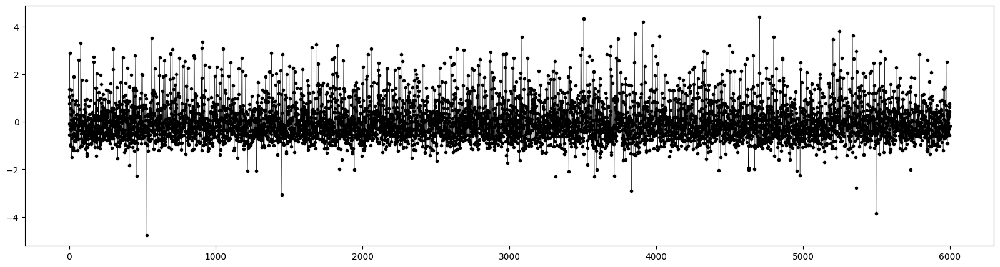

In [ ]:
#Gráfico de errores vs i:

plt.figure(figsize = (20, 5))
plt.plot(muestras_CH_New, '.-', color = "black", linewidth = 0.3)
plt.show()

**2. Distribución normal de los datos:**
*   H0: Los errores se distribuyen normal
*   H1: Los errores no se distribuyen normal

Dado un valor P de 0.00 de la prueba Jarque-Bera mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que los datos no se distribuyen normal.

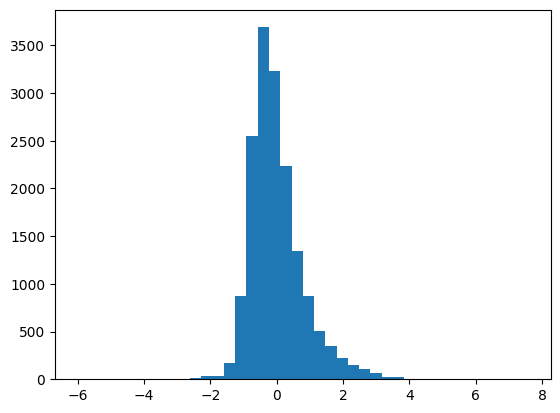

In [ ]:
# Histrograma de los residuales
plt.hist(results_CH_New.resid, bins =40)

plt.show()

**3. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.999 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero.

In [ ]:
# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(results_CH_New.resid, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic: ", t_stat)
print("P-value: ", p_value)

One-sample t-test para la media de los residuos:
T-statistic:  -9.084836843699295e-13
P-value:  0.9999999999992751


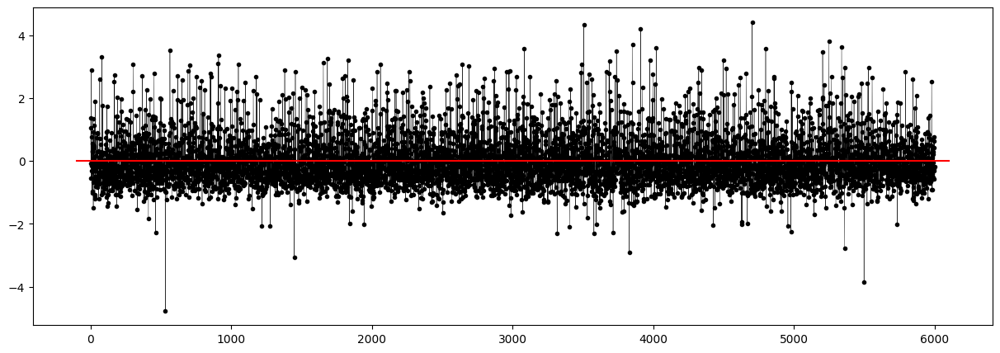

In [ ]:
#Gráfico de errores vs i, con media cero:

plt.figure(figsize = (15, 5))
plt.plot(muestras_CH_New, '.-', color = "black", linewidth = 0.3)
plt.plot([-100,6100], [0,0], color = "red")
plt.show()

**4. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia para pensar que los errores no son homocedásticos.

In [ ]:
test = sms.het_breuschpagan(results_CH_New.resid, results_CH_New.model.exog)
name = ["Largrange multiplier statistic", "p-value", "f-value", "f p-value"]
lzip(name, test)

[('Largrange multiplier statistic', 621.5544581385352),
 ('p-value', 2.1406270698606056e-134),
 ('f-value', 215.23669612075105),
 ('f p-value', 5.726859565432291e-137)]

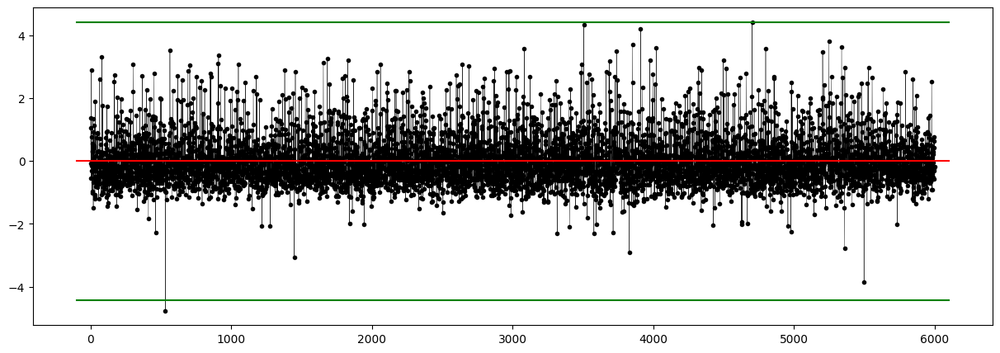

In [ ]:
#Gráfico de errores vs i, con media cero y varianza constante:

mx=max(muestras_CH_New)

plt.figure(figsize = (15, 5))
plt.plot(muestras_CH_New, '.-', color = "black", linewidth = 0.3)
plt.plot([-100,6100], [0,0], color = "red")
plt.plot([-100,6100], [mx,mx], color = "green")
plt.plot([-100,6100], [-mx,-mx], color = "green")

plt.show()

En este modelo de regresión de mínimos cuadrados ordinarios (OLS), posterior a la ejecución del proceso de Lasso, hemos confirmado que se cumplen los supuestos y hemos obtenido un coeficiente de determinación (R2) de 0.51. Esto indica que las variables explicativas son capaces de explicar el 51% de la variabilidad del modelo. Tras eliminar las variables de longitud y latitud, hemos solucionado el problema de multicolinealidad. Sin embargo, es importante destacar que el modelo no logra explicar la misma cantidad de varianza en los datos como lo hacía antes de aplicar el proceso de Lasso.

## **Parte E**

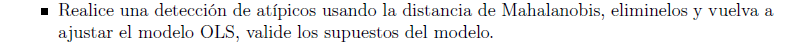

### **Análisis y tratamiento de atípicos multivariantes:**

Antes de construir el modelo, conviene revisar la presencia de datos atípicos en los datos que puedan llegar a afectarlo. Para ello, se calculan las distancias de mahalanobis para identificar los atípicos multivariantes existentes:

Dado que el porcentaje de datos atípicos multivariantes presentes en los datos es bajo (menor al 5%), no se tiene suficiente contexto para su imputación y puesto que no se tiene contexto adicional que permita determinar si su eliminación significaría un alto costo para el negocio, se procede entonces a su eliminación.

### **Distancias de Mahalanobis**

In [ ]:
Y_D_MH = df_california_housing_new['MedHouseVal']
X_D_MH = df_california_housing_new[['MedInc', 'HouseAge','AveRooms']]

In [ ]:
print(Y_D_MH.shape)
print(X_D_MH.shape)

(20640,)
(20640, 3)


#### **Alpha=0.01 correspondiente a un q=0.99:**

In [ ]:
x = X_D_MH
x_menos_mu = x - np.mean(x)  ### Calculando los datos menos la media
cov = x.cov()                ### Calculando la covarianza
inv_cov = np.linalg.inv(cov) ### Invertir matriz de covarianza

left_term = np.dot(x_menos_mu, inv_cov)  #### (x-mean(x)) * S^(-1)
mahal2 = np.dot(left_term, x_menos_mu.T) #### (x-mean(x)) * S^(-1) * x-mean(x))^T
mahal = np.sqrt(mahal2)                  #### Sacamos raiz para que me queden las distancias directamente
D_h = mahal.diagonal()

### Definimos un Cot-off
from scipy.stats import chi2
alpha = 0.01
C = np.sqrt(chi2.ppf(1-alpha, df = x.shape[1]))
C

x["outlier_10"] = np.zeros(x.shape[0])
x.loc[D_h > C, "outlier_10"] = 1

In [ ]:
# Calculando el número de outliers y cuánto representan de los datos totales:
print("Número de outliers: ",x["outlier_10"].sum())
print("Porcentaje de outliers: ",(x["outlier_10"].sum()/len(x["outlier_10"]))*100,"%")

Número de outliers:  448.0
Porcentaje de outliers:  2.1705426356589146 %


In [ ]:
print("# de outliers: ", sum(D_h > C))

print(x.loc[D_h > C,]) ## para extraer los puntos que son outliers

# de outliers:  448
        MedInc  HouseAge  AveRooms  outlier_10
131    11.6017      18.0  8.335052         1.0
155     8.8793      52.0  8.972868         1.0
407     8.8342      52.0  8.345205         1.0
409    10.0825      52.0  8.209016         1.0
494     9.3959      52.0  7.512097         1.0
...        ...       ...       ...         ...
20163  12.6320       5.0  7.462963         1.0
20376  10.2614      16.0  6.421277         1.0
20380  10.1597      16.0  7.606936         1.0
20426  10.0472      11.0  9.890756         1.0
20436  12.5420      10.0  9.873315         1.0

[448 rows x 4 columns]


In [ ]:
# Borrar filas correspondientes a los índices obtenidos
Y_D_MH_New = Y_D_MH.drop(x.index[D_h > C])
X_D_MH_New = X_D_MH.drop(x.index[D_h > C])
X_D_MH_New = X_D_MH_New.drop("outlier_10", axis=1) # Borramos la columnas para identificar outliers

In [ ]:
print(Y_D_MH_New.shape)
print(X_D_MH_New.shape)

(20192,)
(20192, 3)


### **Hold Out (80-20):**

In [ ]:
#Hold Out
X_train_CH_D_MH, X_test_CH_D_MH, Y_train_CH_D_MH, Y_test_CH_D_MH = train_test_split(X_D_MH_New, Y_D_MH_New, test_size=0.2, random_state=42)
print(X_train_CH_D_MH.shape)
print(X_test_CH_D_MH.shape)

(16153, 3)
(4039, 3)


### **Modelo OLS**

In [ ]:
X = sm.add_constant(X_train_CH_D_MH) ## Variables explicativas o predictoras nuevas
model_CH_D_MH = sm.OLS(Y_train_CH_D_MH, X) ## Variable dependiente y podemos dejar la del paso anterior
results_CH_D_MH = model_CH_D_MH.fit()
print(results_CH_D_MH.summary())

                            OLS Regression Results                            
Dep. Variable:            MedHouseVal   R-squared:                       0.514
Model:                            OLS   Adj. R-squared:                  0.514
Method:                 Least Squares   F-statistic:                     5687.
Date:                Wed, 31 May 2023   Prob (F-statistic):               0.00
Time:                        01:53:10   Log-Likelihood:                -18708.
No. Observations:               16153   AIC:                         3.742e+04
Df Residuals:                   16149   BIC:                         3.746e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.4581      0.034     13.586      0.0

### **Validación de supuestos**

**1. Autocorrelación en los errores:**
*   H0: No hay autocorrelación en los errores
*   H1: Hay autocorrelación en los errores

Dado un estadístico de prueba de 2.003 de la prueba Durbin-Watson que está entre 1.5 y 2.5, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que exista autocorrelación entre los errores.


In [ ]:
import random

muestras_CH_D_MH = random.sample(sorted(results_CH_D_MH.resid), k=6000)

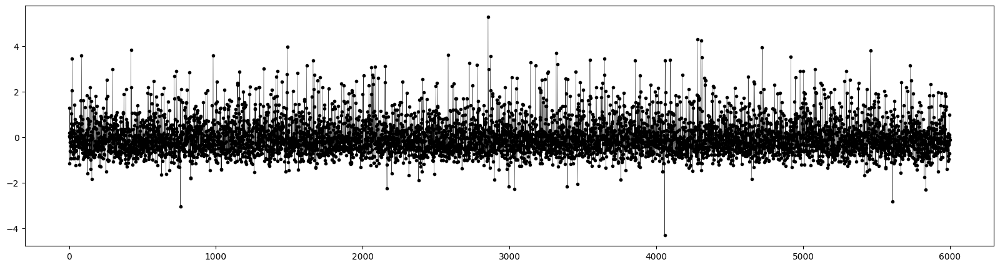

In [ ]:
#Gráfico de errores vs i:

plt.figure(figsize = (20, 5))
plt.plot(muestras_CH_D_MH, '.-', color = "black", linewidth = 0.3)
plt.show()

**2. Distribución normal de los datos:**
*   H0: Los errores se distribuyen normal
*   H1: Los errores no se distribuyen normal

Dado un valor P de 0.00 de la prueba Jarque-Bera mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que los datos no se distribuyen normal.

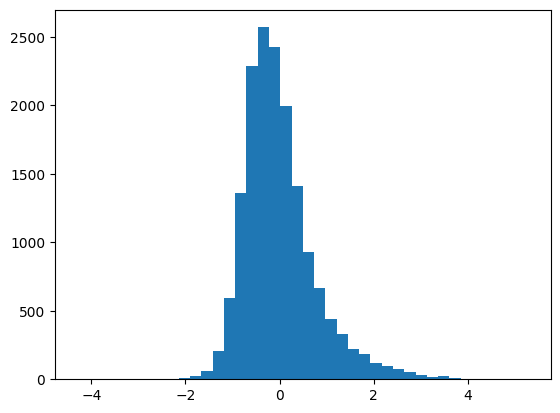

In [ ]:
# Histrograma de los residuales
plt.hist(results_CH_D_MH.resid, bins =40)

plt.show()

**3. Media de los errores:**
*   H0: La media de los errores es igual a cero
*   H1: La media de los errores es diferente de cero

Dado un valor P de 0.999 de un One-Sample t-test mayor que (>=) un alpha de 0.05, no es posible rechazar H0, por tanto, no hay evidencia suficiente para afirmar que la media de los errores es diferente de cero.

In [ ]:
# Realizar el one-sample t-test
t_stat, p_value = ttest_1samp(results_CH_D_MH.resid, 0)

# Imprimir los resultados
print("One-sample t-test para la media de los residuos:")
print("T-statistic: ", t_stat)
print("P-value: ", p_value)

One-sample t-test para la media de los residuos:
T-statistic:  -4.151767998352337e-13
P-value:  0.9999999999996687


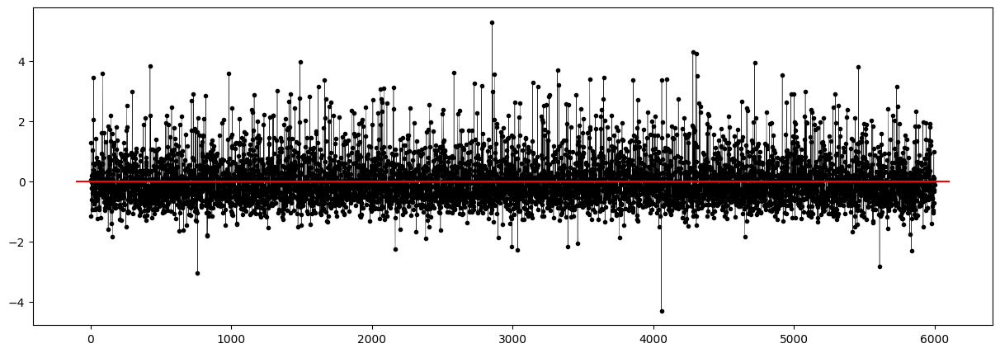

In [ ]:
#Gráfico de errores vs i, con media cero:

plt.figure(figsize = (15, 5))
plt.plot(muestras_CH_D_MH, '.-', color = "black", linewidth = 0.3)
plt.plot([-100,6100], [0,0], color = "red")
plt.show()

**4. Varianza constante de los errores:**
*   H0: Los errores son homocedásticos
*   H1: Los errores no son homocedásticos

Dado un valor P de 0 de una prueba Breuschpagan menor que (<) un alpha de 0.05, es posible rechazar H0, por tanto, hay evidencia para pensar que los errores no son homocedásticos.

In [ ]:
test = sms.het_breuschpagan(results_CH_D_MH.resid, results_CH_D_MH.model.exog)
name = ["Largrange multiplier statistic", "p-value", "f-value", "f p-value"]
lzip(name, test)

[('Largrange multiplier statistic', 175.12847018811112),
 ('p-value', 9.940615792041909e-38),
 ('f-value', 59.00138533869554),
 ('f p-value', 6.297514874458437e-38)]

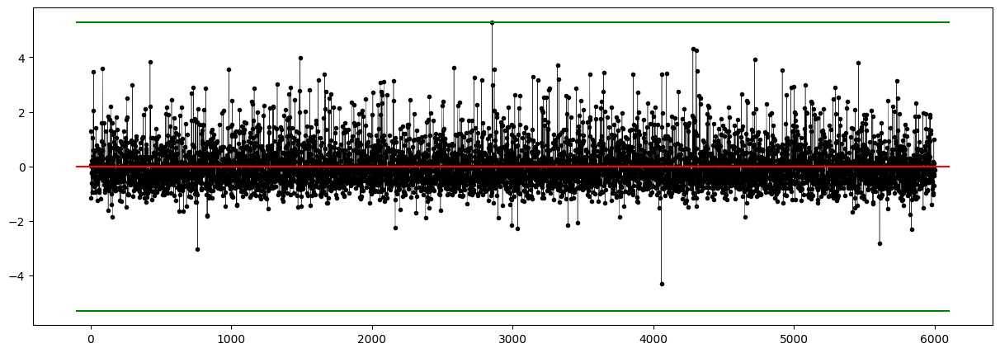

In [ ]:
#Gráfico de errores vs i, con media cero y varianza constante:

mx=max(muestras_CH_D_MH)

plt.figure(figsize = (15, 5))
plt.plot(muestras_CH_D_MH, '.-', color = "black", linewidth = 0.3)
plt.plot([-100,6100], [0,0], color = "red")
plt.plot([-100,6100], [mx,mx], color = "green")
plt.plot([-100,6100], [-mx,-mx], color = "green")

plt.show()

### **Conclusión punto 3:**

En un modelo de mínimos cuadrados ordinarios (OLS), es preferible que se cumplan todos los supuestos con un R2 de 0.5 en lugar de que no se cumpla ninguno con un R2 de 0.9. Aunque un R2 más alto indica una mayor capacidad del modelo para explicar la variabilidad de los datos, si los supuestos fundamentales del modelo no se cumplen, se pone en duda la validez de los resultados y las inferencias realizadas. Si los supuestos no se cumplen, los coeficientes estimados pueden ser sesgados o ineficientes, lo que puede conducir a conclusiones incorrectas o poco confiables. Por lo tanto, es fundamental que se cumplan los supuestos del OLS para que los resultados sean válidos y confiables, incluso si el R2 es más bajo.

En nuestro estudio, al aplicar el método Lasso para la selección de características y reducción de variables, observamos un resultado interesante. A pesar de la eliminación de variables, encontramos que el coeficiente de determinación (R2) se mantiene igual con todas las variables incluidas en el modelo (0.516-Modelo OLS Inicial vs 0.514-Modelo OLS después de Lasso). 

Este hallazgo nos puede indicar que las variables eliminadas por Lasso no aportan información adicional para la predicción de la variable objetivo. Esto sugiere que dichas variables pueden ser redundantes o tener un efecto mínimo en la capacidad del modelo para explicar la variabilidad en los datos. Aunque su exclusión no afectó el R2, la reducción de variables aún podría tener un impacto beneficioso en términos de simplicidad y generalización del modelo.

En conclusión, el hecho de que el R2 se mantenga constante con todas las variables incluidas después de aplicar Lasso nos proporciona información valiosa sobre la relevancia y redundancia de las variables en nuestro modelo.

# **Conclusiones Generales:**

En este estudio, se evaluaron y compararon diferentes modelos de regresión: el OLS, el Modelo Ridge, el Modelo Lasso y el Modelo Elastic-Net, así como el uso de las distancias de Mahalanobis en el análisis de atípicos multivariados.

Los modelos de regularización son herramientas efectivas para abordar problemas de multicolinealidad y selección de características en el análisis de regresión. En el primer punto, observamos que el Modelo Elastic-Net ofreció un rendimiento superior en términos de precisión y selección de características en comparación con el Modelo Ridge y el Modelo Lasso. Esta combinación de penalizaciones L1 y L2 permitió una mayor flexibilidad y adaptabilidad del modelo, resultando en mejores resultados predictivos. En el segundo punto, observamos qué aunque Lasso permite reducir dimensionalidad, ni OLS ni Lasso son modelos de regresión adecuados para variables discretas ordinales (años). En el tercer punto, Lasso nos permitió reducir dimensionalidad y Mahalanobis limpiar la base de datos, obteniendo un modelo que pese a tener un R2 bajo, cumple con todos los diferentes supuestos.

Cabe resaltar que la incorporación de las distancias de Mahalanobis en el análisis multivariado demostró ser una estrategia efectiva para la detección de observaciones atípicas. Estas distancias, basadas en la matriz de covarianza o en la matriz de correlación, proporcionan una medida de la distancia entre cada observación y la distribución de los datos, teniendo en cuenta la estructura multivariada. En nuestro estudio, las distancias de Mahalanobis permitieron identificar de manera más precisa y robusta las observaciones atípicas, mejorando así la calidad y confiabilidad de los resultados.

En resumen, estas técnicas combinadas ofrecen un enfoque integral para el análisis de datos complejos y pueden mejorar la interpretación y generalización de los resultados obtenidos en diversos campos de estudio.

# **Bibliografía**


Raschka, S., Mirjalili, Vahid. (2019). Python Machine Learning: Aprendizaje automático y aprendizaje profundo con Python, scikit-learn y TensorFlow. Marcombo. 2da Edición.

Peña, D. (2002). Análisis de Datos Multivariantes. MCGRAW-HILL

Aiken, L. S., & West, S. G. (1991). Multiple Regression: Testing and interpreting interactions. Newbury Park, CA: Sage Publications

Cohen, J., & Cohen, P. (1983). Applied multiple regression/correlation analysis for the behavioral sciences (2nd ed.). Hillsdale, NJ: Lawrence Erlbaum 